## Notes
things to plot/try:
1. ~~anticipatory vs consumatory licking frequency~~
2. ~~change anticipatory licking window~~
3. trial frequency - different windows (e.g. 1 min, 1hr, 4hr, etc.)
    - are there bursts of trials? is this related to what the previous trial type was?
    - number of trials in 1 min after a water trial vs blank?
4. inter-trial interval - time between last sample of one trial and first sample of the next
    - is this related to trial type? condition?
5. previous trial contingencies
6. pokes/trial 

#### Pretraining experience facilitates acquisition of a sensory association task

Sensory association training is an automated home-cage task that trains animals to associate an air puff with a water reward, where mice are acclimated to a training cage for 24 hours, then a gentle air puff is introduced for 24 hours of training. The eighty-five percent rule for learning (Wilson, .. Cohen, 2019) indicates that learning should be optimized when mice recieve stimulus (water reward and air puff) trials 80%-85% of the time, and blank (no water or puff) trials 15-20% of the time. However, prior experience influences the way that animals learn. Priming can be defined as the way that previous experience influences current behavior in a non-conscious way (Shackter and buffner, 1998; kristjansson 2023). In the context of task learning, this involves pre-exposure to an unrelated context prior to initiation of task learning that facilitates learning of the task. In this training paradigm, mice can be primed during the first 24h in the cage, during which they get used to the cage and lick port, and recieve water reward but no air, before they start learning the task. This analysis suggests that modulating probability of water delivery from the lick port during this pretraing period affects the way animals learn the task. In particular, animals that experience water delivery 100% of the time durning this pretraining period learn the task faster than animals that experience water delievery only 80% of the time.

#### Citations

Audette, Barth 2019 Rapid Plasticity of Higher-Order Thalamocortical Inputs during Sensory Learning

Bernhard, Barth 2020 An automated homecage system for multiwhisker detection and discrimination learning in mice

Eunsol citation

Song, Froemke 2022 Input-Specific Inhibitory Plasticity Improves Decision Accuracy Under Noise

## File Structure

### File structure: 

- 1st column - time stamp (seconds since start of file - reset cage)
- 2nd column - 1= trial initiated
- 3rd column - 2 = lick/ 0 = no lick
- 4th column - (water vs blank)
    - 3,4,5,7 = water
        - 1st wait time (wait time before puff) = 3
        - Puff start = 4
        - 2nd wait time (wait time before water) = 5
        - 3rd wait time (time out) = 7
        - 9 = blank
- 5th column - random delay before the puff
- 6th column -  1 = puff, 0 = no puff (Note: SATcode does not have 6th column)
    - present in allreward acc code

### Trial Structure:

~0.1 s (100ms) increments from trial initiation to water delivery and during timeout
    - sometimes 0.09s to 0.11s

on water trials (col 2 = 1), col 5 (delay) is only non-zero when col 3 = 3 (wait before puff)

all blank trials have one sample from the timeout (7) at end of trial

### Example

time (s), trial, lick, trial type, delay time, (puff)

2716.76,   1,     0,    3,          377


### File name structure:

(user added txt)temptest.txtmm_dd_yy_T_hh_mm_ss 

time formatted as military (i.e. 2pm = 14_00_00)


## Load Files and Format Data

In [3]:
import re
import os
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.backends.backend_pdf as bp
import seaborn as sns
import datetime

import analysis_helper

In [4]:
def timefromfile(filename):
    "Convert filename to timestamp for start of trials"
    datetime = re.findall("\d\d_\d\d_\d\d_T_\d\d_\d\d_\d\d", filename)[0]
    datetime = datetime.replace("_", "-", 2).replace("_T_", " ").replace("_", ":")
    return pd.Timestamp(datetime)

In [5]:
def loadfile(filename):
    '''Given a string filename, loads in the data, extracts the start time from the filename, and formats the timestamps based on the start time.'''
    animal = pd.read_csv(filename, header=None)
    animal = animal.rename(columns={0:"timestamp",1:"poke", 2:"lick", 3:"water", 4:"delay"})
    datetime = timefromfile(filename)
    animal["timestamp"] = pd.to_datetime(animal["timestamp"], unit="s", origin=pd.Timestamp(datetime))
    animal["delay"] = pd.to_timedelta(animal["delay"], unit="ms")
    
    return animal.iloc[:, 0:5]

In [6]:
def getTrials (tp):
    (idx, x) = tp
    return pd.Series([idx for i in range(x)], dtype="int")

In [7]:
def labelTrials (animal):
    '''Given the set of data for an animal, labels each sample in a trial with the trial type and the trial number, numbering trials consecutively from 1.
    The number of trials, and the number of each trial type, matches v16 of the matlab analysis.
    '''
    #first sample for each new trial - current water code is not 7 (timeout) and previous is 7 plus first and last sample (for diff alignment)
    trial_boundaries = pd.concat([animal.iloc[[0]], animal[(animal["water"]!=7) & (animal["water"].shift() == 7)], animal.iloc[[animal.shape[0]-1]]])

    trial_count = pd.Series(trial_boundaries.index)    
    #get number of samples per trial (difference in sample number between previous boundary and current boundary)
    trial_count = pd.Series(enumerate(trial_count.diff().fillna(0).astype('int').tolist()))
    #enumerate trial number from first sample to all samples in trial
    trial_count = trial_count.map(getTrials).explode()[1:]
    trial_count.index = range(0, trial_count.shape[0])
    animal.insert(1, "trial no", trial_count)
    #set trial no for last sample
    animal.loc[animal.shape[0] - 1, "trial no",] = trial_boundaries.shape[0] -1

    #label trial types
    go = animal.groupby(["trial no"]).filter(lambda x: (x["water"]==3).any())
    go["trial type"] = ["water" for i in range(go.shape[0])]
    animal["trial type"] = go["trial type"]
    animal["trial type"] = animal["trial type"].fillna(value="blank")

    return animal

In [8]:
def init_data(data, animal, cond):
    '''Set animal and condition and update lick value to binary 1/0'''
    data.loc[data["lick"] == 2,"lick"] = 1
    data["animal"] = animal
    data["condition"] = cond
    return data

In [16]:
def load_sat(pSAT, animals, name, hm4di_metadata, metadata):
    for d in os.listdir(pSAT):
        print(d)

        p = pSAT + "\\" + d
        #guarantees files opened in time order (path list is arbitrary)
        fs = os.listdir(p)
        fs.sort()
        curranimal = [] 
        
        #all files concatenated in order
        time = 0
        SAT_start = 0
        for f in fs:
            if (os.path.isfile(p + "\\" + f)):      
                curranimal.append(loadfile(p + "\\" + f))        
                if time == 0:
                    time = timefromfile(p + "\\" + f)             
        
        curranimal = labelTrials(pd.concat(curranimal, ignore_index=True))

        #align animal metadata
        if not (metadata[metadata["Animal ID"] == d].empty): 
            airon = metadata[metadata["Animal ID"] == d].reset_index().loc[0, "air on"]
            if not pd.isna(airon):
                t = re.findall("\d?\d",airon)

            an_meta =  metadata[metadata["Animal ID"] == d].reset_index()
            acc = an_meta.loc[0, "ACC days"]
            curranimal["age"] = an_meta.loc[0, "Age"]
            curranimal["sex"] = an_meta.loc[0, "Sex"]
            curranimal["strain"] = an_meta.loc[0, "Strain"]
            SAT_start = pd.Timestamp(year=time.year, month=time.month, day=time.day, hour=int(t[0]), minute=int(t[1])) + pd.to_timedelta(acc, unit="D")  
        elif not (hm4di_metadata[hm4di_metadata["Animal ID"] == d].empty):
            acc = hm4di_metadata[hm4di_metadata["Animal ID"] == d].reset_index()["Acclimation (days)"][0]
            SAT_start  = pd.Timestamp(year=time.year, month=time.month, day=time.day, hour=12) + pd.to_timedelta(acc, unit="D")  
        else:
            print("no metadata")
            
        curranimal = init_data(curranimal, d, name)
        curranimal["SAT_start"] = SAT_start
        curranimal["acc"] = acc
        animals = pd.concat([animals, curranimal])
    return animals

def load_100(animals, path_100_80, metadata):
    for d in os.listdir(path_100_80):
        print(d)
        
        p = path_100_80 + "\\" + d
        #animal directory (path list is arbitrary)
        andirs = os.listdir(p)
        andirs = sorted(andirs, key=str.lower)
        curranimal = []
        for d2 in andirs:
            p2 = p + "\\" + d2
            #acc/SAT - sort if multiple files
            fs = os.listdir(p2)
            fs.sort()
            SAT_start = 0
            for f in fs:            
                if os.path.isfile(p2 + "\\" + f):
                    curranimal.append(loadfile(p2 + "\\" + f))
                    if (d2 == "SAT") & (SAT_start == 0):
                        SAT_start = timefromfile(p2 + "\\" + f)
        
        #all files concatenated in order   
        curranimal = labelTrials(pd.concat(curranimal, ignore_index=True))
        curranimal["SAT_start"] = SAT_start
        
        curranimal = init_data(curranimal, d, "SAT_100_80")
        if not (metadata[metadata["Animal ID"] == d].empty): 
            airon = metadata[metadata["Animal ID"] == d].reset_index().loc[0, "air on"]
            if not pd.isna(airon):
                t = re.findall("\d?\d",airon)
                
            an_meta =  metadata[metadata["Animal ID"] == d].reset_index()
            curranimal["age"] = an_meta.loc[0, "Age"]
            curranimal["sex"] = an_meta.loc[0, "Sex"]
            curranimal["strain"] = an_meta.loc[0, "Strain"]
            print(an_meta.loc[0, "ACC days"])
            curranimal["acc"] = an_meta.loc[0, "ACC days"]
        
        animals = pd.concat([animals, curranimal])
        animals["acc"] = animals["acc"].fillna(1)
    return animals

def load_all_data(SATpaths, path_100_80, hm4di_metadata, metadata):
    animals = pd.DataFrame()
    
    for (pSAT, name) in SATpaths:
        print(name)
        animals = pd.concat([animals, load_sat(pSAT, pd.DataFrame(), name, hm4di_metadata, metadata)])
    animals = pd.concat([animals, load_100(pd.DataFrame(), path_100_80, metadata)])
    
    animals = animals.set_index(["condition", "animal", "trial no"])

    return animals

In [17]:
#load metadata
path_metadata = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\Animal lists.xlsx"
hm4di_metadata = pd.read_excel(path_metadata)

path_metasat = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\behavior metasheet.xlsx"
sat_metadata = pd.read_excel(path_metasat)
print(sat_metadata.columns)
#load data for prelim animals
prelim_path_SAT = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\prelim\\SAT"
prelim_path_100_80 = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\prelim\\100 80 SAT"
prelim = load_all_data([(prelim_path_SAT, "SAT")], prelim_path_100_80, hm4di_metadata, sat_metadata)

#load data for all animals
all_SAT = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\all animals\\SAT"
all_100_80 = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\all animals\\100 80"
all_mch = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\all animals\\mcherry"
all_hm4di = "C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\Eunsol data\\all animals\\hM4Di SAT"
all_animals = load_all_data([(all_SAT, "SAT"), (all_mch, "mcherry"), (all_hm4di, "hm4di")], all_100_80, hm4di_metadata, sat_metadata).reset_index()
all_animals = all_animals[(all_animals["animal"] != "JOV1") & (all_animals["animal"] != "JND2")].set_index(["condition", "animal", "trial no"])

Index(['Animal ID', 'Strain', 'ACC water %', 'Sex', 'Age', 'ACC days', 'Cage',
       'Time in', 'air on', 'Unnamed: 9'],
      dtype='object')
SAT
GSB8
GXS5
JSS4
NJO1
NLB10
1.0
NLB8
1.0
NLG3
1.0
NLN3
1.0
SAT
GKO6
GSB8
GXC7
GXS4
GXS5
JND2
JOV1
JSS4
NFZ13
NFZ4
NGX5
NJO1
mcherry
MJL2
MJN2
MJN3
MJN5
MYC4
MZG4
MZG5
NBE11
NCY1
NCY4
NCY6
NDR1
NIO15
NIO16
hm4di
LWP2
LWP4
LWP6
LWP8
MKV10
MKV11
MKV14
NAS9
NBX7
NBX9
NEJ1
NJW5
NKZ10
1.0
NKZ3
1.0
NKZ4
NKZ7
1.0
NLB1
NLB10
1.0
NLB3
1.0
NLB8
1.0
NLG3
1.0
NLN3
1.0
NLN5
1.0
NLV2
1.0
NLV3
1.0
NLV5
1.0


In [18]:
aa = all_animals.reset_index()
aa["delta"] = aa["timestamp"] - aa["SAT_start"]

,condition,animal,trial no,timestamp,poke,lick,water,delay,trial type,age,sex,strain,SAT_start,acc,delta


In [374]:
sat = aa[aa["timestamp"] > aa["SAT_start"]]
sat = analysis_helper.deliverydelta(sat)
sat

,condition,animal,trial no,timestamp,poke,lick,water,delay,trial type,age,sex,strain,SAT_start,delta,delivery delta
0,SAT,GKO6,266,2019-05-03 12:30:01.500000000,1,0,3,0 days 00:00:00.517000,water,31.0,M,Sscre x Ai32,2019-05-03 12:25:00,0 days 00:05:01.500000,-1 days +23:59:59.483000
1,SAT,GKO6,266,2019-05-03 12:30:01.600000000,1,0,3,0 days 00:00:00.517000,water,31.0,M,Sscre x Ai32,2019-05-03 12:25:00,0 days 00:05:01.600000,-1 days +23:59:59.583000
2,SAT,GKO6,266,2019-05-03 12:30:01.700000000,1,0,3,0 days 00:00:00.517000,water,31.0,M,Sscre x Ai32,2019-05-03 12:25:00,0 days 00:05:01.700000,-1 days +23:59:59.683000
3,SAT,GKO6,266,2019-05-03 12:30:01.800000000,1,0,3,0 days 00:00:00.517000,water,31.0,M,Sscre x Ai32,2019-05-03 12:25:00,0 days 00:05:01.800000,-1 days +23:59:59.783000
4,SAT,GKO6,266,2019-05-03 12:30:01.900000000,1,0,3,0 days 00:00:00.517000,water,31.0,M,Sscre x Ai32,2019-05-03 12:25:00,0 days 00:05:01.900000,-1 days +23:59:59.883000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
689438,SAT_100_80,NLV5,712,2023-01-02 11:38:52.980000000,0,0,9,0 days 00:00:00,blank,25.0,F,C57,2023-01-01 13:56:14,0 days 21:42:38.980000,0 days 00:00:01.506999872
689439,SAT_100_80,NLV5,712,2023-01-02 11:38:53.069999872,0,0,9,0 days 00:00:00,blank,25.0,F,C57,2023-01-01 13:56:14,0 days 21:42:39.069999872,0 days 00:00:01.596999744
689440,SAT_100_80,NLV5,712,2023-01-02 11:38:53.180000000,0,0,9,0 days 00:00:00,blank,25.0,F,C57,2023-01-01 13:56:14,0 days 21:42:39.180000,0 days 00:00:01.706999872
689441,SAT_100_80,NLV5,712,2023-01-02 11:38:53.280000000,0,0,9,0 days 00:00:00,blank,25.0,F,C57,2023-01-01 13:56:14,0 days 21:42:39.280000,0 days 00:00:01.806999872


In [577]:
#only sat trials
sat = aa[aa["timestamp"] >= aa["SAT_start"]]
sat = analysis_helper.deliverydelta(sat)

#threshold to anticipatory licking
start = pd.to_timedelta(700, unit="ms")
end = pd.to_timedelta(1000, unit="ms")

satant = sat[(sat["delivery delta"] >= start) & (sat["delivery delta"] < end)]

#calculate lick freq
licks = satant.groupby(["condition", "animal", "trial type", "trial no"])["lick"].sum()/0.3
#delta = satant.groupby(["condition", "animal", "trial type", "trial no"])["timestamp"].first() - satant.groupby(["condition", "animal", "trial type"])["timestamp"].first()
#delta = delta.rename("delta")
delta = satant.groupby(["condition", "animal", "trial type", "trial no"])["delta"].first()
timestamp = satant.groupby(["condition", "animal", "trial type", "trial no"])["timestamp"].first()


lickfreqsat = pd.concat([licks, delta, timestamp], axis=1).reset_index()
lickfreqsat = analysis_helper.trialdelta(lickfreqsat)

lickfreqsat


,animal,trial no,condition,trial type,lick,delta,timestamp,trial delta
0,GKO6,272,SAT,blank,10.000000,0 days 00:23:16.230000128,2019-05-03 12:48:16.230000128,0
1,GKO6,273,SAT,blank,10.000000,0 days 02:48:37.809999872,2019-05-03 15:13:37.809999872,1
2,GKO6,280,SAT,blank,6.666667,0 days 02:49:33.180000,2019-05-03 15:14:33.180000000,8
3,GKO6,282,SAT,blank,10.000000,0 days 02:50:06.840000,2019-05-03 15:15:06.840000000,10
4,GKO6,286,SAT,blank,0.000000,0 days 02:50:52.240000,2019-05-03 15:15:52.240000000,14
...,...,...,...,...,...,...,...,...
22419,NIO16,701,mcherry,water,3.333333,1 days 00:00:30.750000128,2022-12-09 12:00:30.750000128,399
22420,NIO16,702,mcherry,water,6.666667,1 days 00:00:34.340000,2022-12-09 12:00:34.340000000,400
22421,NIO16,703,mcherry,water,3.333333,1 days 00:00:38.360000,2022-12-09 12:00:38.360000000,401
22422,NIO16,704,mcherry,water,3.333333,1 days 00:00:41.750000128,2022-12-09 12:00:41.750000128,402


C:\Users\swind\AppData\Local\Temp\ipykernel_11516\481351089.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plottrials["delta"] = plottrials["delta"].astype("timedelta64[m]")


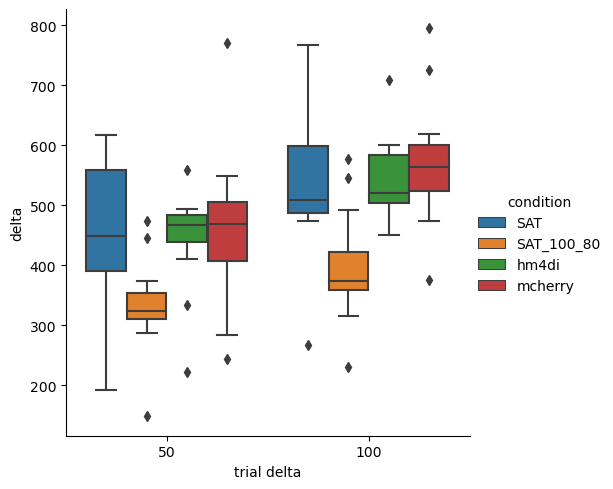

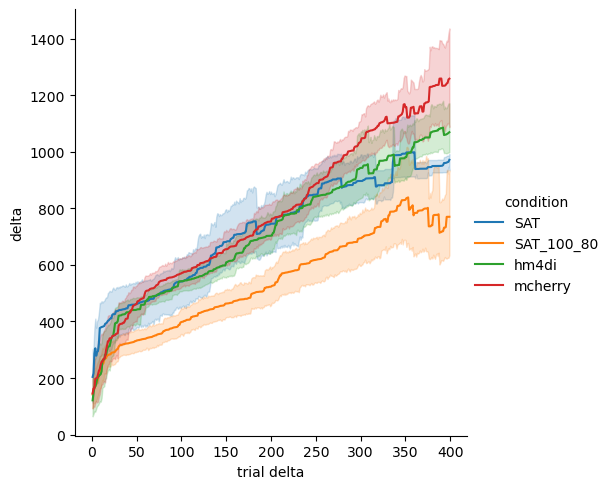

In [578]:
#time to 50 and 100 trials
trials = [50, 100]
plottrials = lickfreqsat[lickfreqsat["trial delta"].isin(trials)]
plottrials["delta"] = plottrials["delta"].astype("timedelta64[m]")
rplt = lickfreqsat.groupby(['condition', 'animal', pd.Grouper(key="timestamp", freq="30 min")]).first().reset_index()
rplt['delta'] = rplt["delta"].astype("timedelta64[m]")
rplt = rplt[rplt["delta"] < 400]
lickfreqsat['delta'] = lickfreqsat["delta"].astype("timedelta64[m]")
lickfreqsat = lickfreqsat[(lickfreqsat["trial delta"] < 400) & (lickfreqsat["trial delta"] > 0) ]
sns.catplot(plottrials, x="trial delta", y="delta", hue="condition", kind="box")
sns.relplot(lickfreqsat,x="trial delta", y="delta", hue="condition", kind="line" )

In [564]:
rplt = lickfreqsat.groupby(['condition', 'animal', pd.Grouper(key="timestamp", freq="1 min")]).mean()
rplt
lickfreqsat

C:\Users\swind\AppData\Local\Temp\ipykernel_11516\2258441840.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  rplt = lickfreqsat.groupby(['condition', 'animal', pd.Grouper(key="timestamp", freq="1 min")]).mean()


,animal,trial no,condition,trial type,lick,delta,timestamp,trial delta
0,GKO6,272,SAT,blank,10.000000,0 days 00:23:16.230000128,2019-05-03 12:48:16.230000128,0
1,GKO6,273,SAT,blank,10.000000,0 days 02:48:37.809999872,2019-05-03 15:13:37.809999872,1
2,GKO6,280,SAT,blank,6.666667,0 days 02:49:33.180000,2019-05-03 15:14:33.180000000,8
3,GKO6,282,SAT,blank,10.000000,0 days 02:50:06.840000,2019-05-03 15:15:06.840000000,10
4,GKO6,286,SAT,blank,0.000000,0 days 02:50:52.240000,2019-05-03 15:15:52.240000000,14
...,...,...,...,...,...,...,...,...
22419,NIO16,701,mcherry,water,3.333333,1 days 00:00:30.750000128,2022-12-09 12:00:30.750000128,399
22420,NIO16,702,mcherry,water,6.666667,1 days 00:00:34.340000,2022-12-09 12:00:34.340000000,400
22421,NIO16,703,mcherry,water,3.333333,1 days 00:00:38.360000,2022-12-09 12:00:38.360000000,401
22422,NIO16,704,mcherry,water,3.333333,1 days 00:00:41.750000128,2022-12-09 12:00:41.750000128,402


In [371]:
#curves right after sat
freq_bin = 100
group = sat.groupby(["condition", "animal", "trial no", "trial type", pd.Grouper(key="delivery delta", freq=pd.offsets.Milli(freq_bin))])
timestamp = group["timestamp"].first()
licks = group[["lick", "poke"]].sum()/(freq_bin/1000)
freqsat = pd.concat([licks, timestamp], axis=1).reset_index()
freqsat

,condition,animal,trial no,trial type,delivery delta,lick,poke,timestamp
0,SAT,GKO6,266,water,-1 days +23:59:59.400000,0.0,10.0,2019-05-03 12:30:01.500000000
1,SAT,GKO6,266,water,-1 days +23:59:59.500000,0.0,10.0,2019-05-03 12:30:01.600000000
2,SAT,GKO6,266,water,-1 days +23:59:59.600000,0.0,10.0,2019-05-03 12:30:01.700000000
3,SAT,GKO6,266,water,-1 days +23:59:59.700000,0.0,10.0,2019-05-03 12:30:01.800000000
4,SAT,GKO6,266,water,-1 days +23:59:59.800000,0.0,10.0,2019-05-03 12:30:01.900000000
...,...,...,...,...,...,...,...,...
652643,mcherry,NIO16,705,water,0 days 00:00:03.200000,0.0,10.0,2022-12-09 12:00:48.269999872
652644,mcherry,NIO16,705,water,0 days 00:00:03.300000,10.0,10.0,2022-12-09 12:00:48.360000000
652645,mcherry,NIO16,705,water,0 days 00:00:03.400000,10.0,10.0,2022-12-09 12:00:48.450000128
652646,mcherry,NIO16,705,water,0 days 00:00:03.500000,10.0,10.0,2022-12-09 12:00:48.549999872


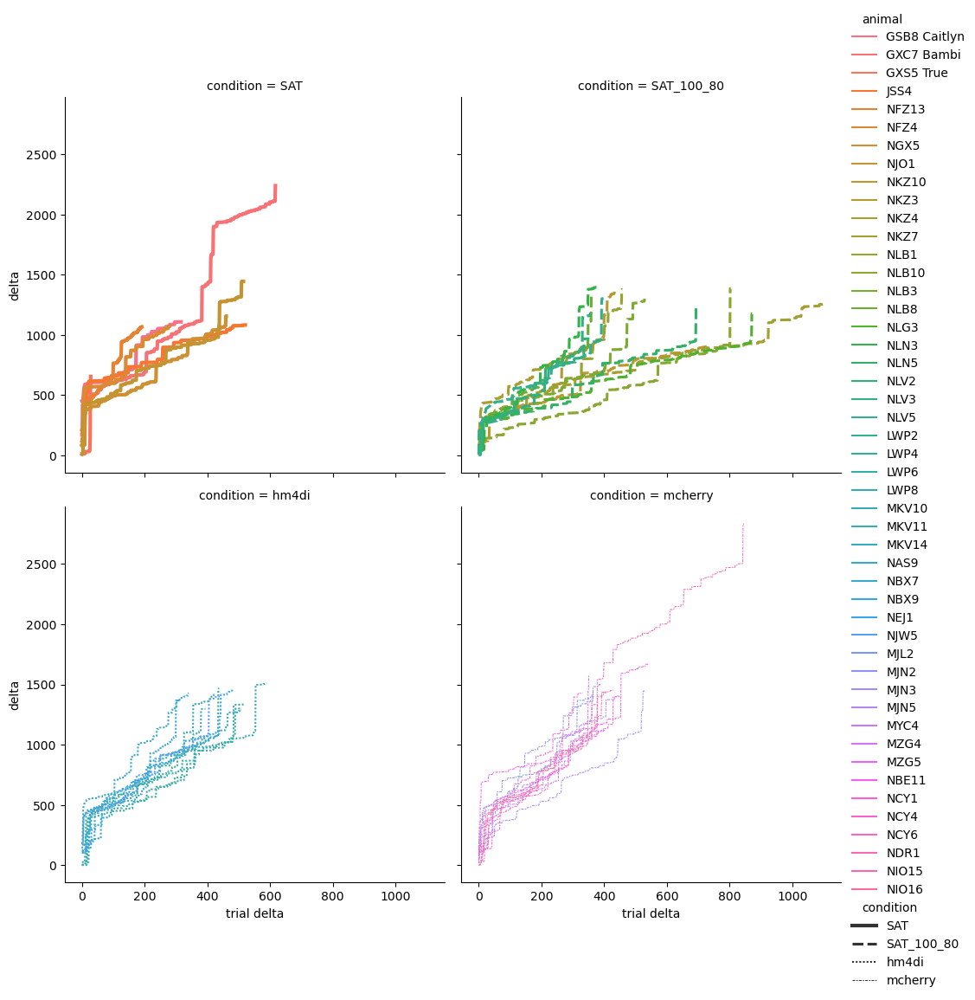

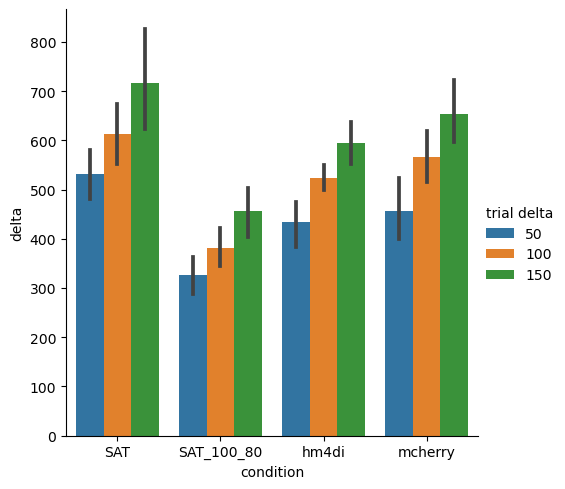

In [101]:
#exclude GKO6 Mason (bad data); JOV1 and JND2 (no learning)
plot = satant.copy()
plot["delta"] = plot["delta"].astype("timedelta64[m]")
sns.relplot(plot, x="trial delta", y="delta", hue="animal", legend="brief", kind="line", errorbar=None, col="condition",col_wrap=2,size="condition", style="condition")
plotcond = (plot["trial delta"] == 50) | (plot["trial delta"] == 100) | (plot["trial delta"] == 150)
sns.catplot(plot[plotcond], x="condition", y="delta", hue="trial delta", kind="bar")

In [115]:
grp = plot.groupby("trial delta")
(grp.get_group(100).set_index(["condition", "animal"]) - grp.get_group(50).set_index(["condition", "animal"])).groupby("condition").mean()

,trial no,lick,delta,trial delta
condition,,,,
SAT,50.0,-4.761905,82.285714,50.0
SAT_100_80,50.0,0.000000,55.357143,50.0
hm4di,50.0,0.277778,89.000000,50.0
mcherry,50.0,1.666667,109.785714,50.0


In [116]:
(grp.get_group(150).set_index(["condition", "animal"]) - grp.get_group(100).set_index(["condition", "animal"])).groupby("condition").mean()

,trial no,lick,delta,trial delta
condition,,,,
SAT,50.0,1.268826e-16,103.857143,50.0
SAT_100_80,50.0,1.666667e+00,73.928571,50.0
hm4di,50.0,1.388889e+00,70.666667,50.0
mcherry,50.0,4.761905e-01,87.071429,50.0


In [119]:
(grp.get_group(300).set_index(["condition", "animal"]) - grp.get_group(250).set_index(["condition", "animal"])).groupby("condition").mean()

,trial no,lick,delta,trial delta
condition,,,,
SAT,50.0,0.666667,89.800000,50.0
SAT_100_80,50.0,-0.714286,79.857143,50.0
hm4di,50.0,1.666667,94.000000,50.0
mcherry,50.0,-1.190476,159.500000,50.0


### Lick Frequencies, Intertrial Intervals, and Number of Trials
Custom Functions for calculation

In [218]:
def resample_for_plot(data, col, bin_size, perf=False, sum=False, how=None):
    '''Resample data into timebins of bin_size and add columm for mean across timebin, maintaining trial type and animal separation.
       Also calculates performance.'''   
    binned = data.groupby(["condition", "trial type", "animal", pd.Grouper(key="timestamp", freq=bin_size)])
    if how=="count":
        binned = binned.count()
    else:
        binned = binned.mean()
    
    binned = binned.reset_index().set_index(["condition", "trial type", "animal"])

    #changes exact timebin to difference from start to align animals by timebin
    #sort by timestamp ensures earliest timestamp regardless of what trial type it contains
    #offset SAT80 data by 1 day of acclimation to align SAT80 and SAT100 data

    gp_cond = binned.groupby("condition")
    sat = gp_cond.get_group("SAT")
    sat_100 = gp_cond.get_group("SAT_100_80")
    dt_sat = sat["timestamp"] - sat.sort_values("timestamp").groupby("animal")["timestamp"].first() - pd.to_timedelta(24, unit="H")
    dt_100 = sat_100["timestamp"] - sat_100.sort_values("timestamp").groupby("animal")["timestamp"].first() - pd.to_timedelta(24, unit="H")
    binned["delta"] = pd.concat([dt_sat, dt_100])
    
    #unstack animals into columns and average lick freq across a timebin
    binned = binned.reset_index().set_index(["condition", "trial type", "animal", "delta"])[col]
    
    #calculate performance (diff between water and blank trials)
    binned = binned.unstack(level=["trial type"])
    if perf:
        binned["perf"] = binned["water"] - binned["blank"]
    if sum:
        binned["sum"] = binned["water"] + binned["blank"]
    binned = binned.stack(level="trial type").sort_index(level="animal")

    #calculate mean performance and lick freq
    binned = binned.unstack(level=["animal"])
    binned["mean"] = binned.mean(axis=1)
    return binned.stack(level=["animal"])

In [ ]:
def getFreq(animals, start, end, bin_size):
    '''Calculates licking frequency based on the given lick window start and end and resampling bin size. 
    Calculates water delivery time from trial start time and delay and treats it as 0 for lick window calculations.

    Arguments:
    animals -- dataframe with animal data. must have a animal, trial no, and condition column or index
    start -- start of lick window in ms as an int
    end -- end of lick window in ms as an int
    bin_size -- frequency to resample trials into, as a string
    Requires: start <= end
    '''

    #calculate water delievery start (and backpopulate across all samples in a trial)
    grouped = animals.groupby(["condition", "animal", "trial no"])
    animals["water start"] = grouped["timestamp"].first() + grouped["delay"].first() + pd.to_timedelta("1s")
    animals["delivery delta"]  = animals["timestamp"] - animals["water start"]
    
    #get trials in given licking time region  
    licks = animals[(animals["delivery delta"] >= pd.to_timedelta(start, unit="ms")) & (animals["delivery delta"] < pd.to_timedelta(end, unit="ms"))]
    
    #convert licks to frequencies - sum number of licks in a trial and divide by ant lick window (rounding for float conversion)
    #associate each trial with a time and trial type - take from first sample of trial
    licks_grouped = licks.groupby(["condition", "animal", "trial no"])
    freqs = pd.concat([licks_grouped["trial type"].first(), licks_grouped["timestamp"].first(), licks_grouped["lick"].sum()/abs((end-start)/1000)], axis=1)

    #resample into timebins and average lick freq across timebin, maintaining trial type and animal separation
    #binned_freqs = resample_for_plot(freqs, "lick", bin_size, perf=True)
    return freqs

In [ ]:
def getInterval(animals, bin_size):
    '''Calculates the time between the end of a trial and the start of the next'''
    grouped = animals.groupby(["condition", "animal", "trial no"])
    interval = (grouped["timestamp"].first().shift(-1) - grouped["timestamp"].last()).rename("interval")
    inter_intervals = pd.concat([grouped["timestamp"].first(), grouped["trial type"].first(), interval], axis=1)
    #the last trial has no next trial, and so difference should be NaT
    mask = inter_intervals.reset_index().groupby("animal").last().loc[:, "condition":"trial no"].reset_index()
    mask = mask[["condition", "animal", "trial no"]]
    mask_idx = list(mask.itertuples(index=False, name=None))
    inter_intervals.loc[mask_idx, "interval"] = pd.NaT
    #inter_intervals = inter_intervals[["trial type", "interval"]]
    return inter_intervals #resample_for_plot(inter_intervals, "interval", bin_size)


In [ ]:
def getNumTrials(animals, bin_size, perf):
    num_trials = resample_for_plot(animals.reset_index(), "trial no", bin_size, sum=True, perf=perf, how="count")
    return num_trials

## Do SAT100 and SAT80 animals learn differently?

Quantifying learning through behavior:
1. Depth of performance decrease after air is turned on
1. Time to positive performance after air is turned on
1. Time to performance reaching some other threshold after air is turned on (e.g. time to performance > 1)
1. ~~Time between trials~~
1. ~~Differences in consummatory licking frequency~~
1. Slope of recovery after air is turned on

To Plot:
1. ~~for both SAT100 and SAT80~~
    1. num trials
    1. ant lick
    1. ant lick long
    1. con lick
    1. interval
1. ~~performance: SAT100 vs SAT80~~
1. ~~mark start of air/align bins to start of air~~
1. ~~different bin sizes (4H, 2H, 1H)~~
1. by each animal



### 4H Bins

In [ ]:
#analysis (4H bins)
af4 = resample_for_plot(getFreq(all_animals, -300,0, "4H"), "lick", "4H", perf=True)
afl4 = resample_for_plot(getFreq(all_animals, -500,0, "4H"), "lick", "4H", perf=True)
cf4 = resample_for_plot(getFreq(all_animals, 0,500, "4H"), "lick", "4H", perf=True)
i4 = resample_for_plot(getInterval(all_animals, "4H"), "interval", "4H", sum=True)
nt4 = (getNumTrials(all_animals, "4H", False))
#plotting
af4_plot = af4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
afl4_plot = afl4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
#afs4_plot = afs4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cf4_plot = cf4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
i4_plot = i4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"]).sort_values("delta")
nt4_plot = nt4.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cmap = mpl.colors.ListedColormap(["red", "green"])

ValueError: cannot handle a non-unique multi-index!

'\n#plot SAT_100 data\ncmap = mpl.colors.ListedColormap(["red", "green"])\nfig2, axs2 = plt.subplots(3, 1, sharex=True, figsize=(12, 12))\nnt4_plot.loc[:, ("SAT_100_80")][["sum"]].plot(style="k", ax=axs2[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)\naxs2[0].set_title("Number of Trials")\n#i4_plot.loc[:, ("SAT_100_80")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs2[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)\naxs2[1].set_title("Anticipatory Licking Frequency (300 ms)")\naf4_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[1], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)\naxs1[2].set_title("Performance")\naf4_plot.loc[:, ("SAT_100_80", "perf")].plot(style="ko-", ax=axs2[2], colormap=cmap, ylabel="Performance", legend=False)\n#afl4_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)\n#axs2[3].set_title("An

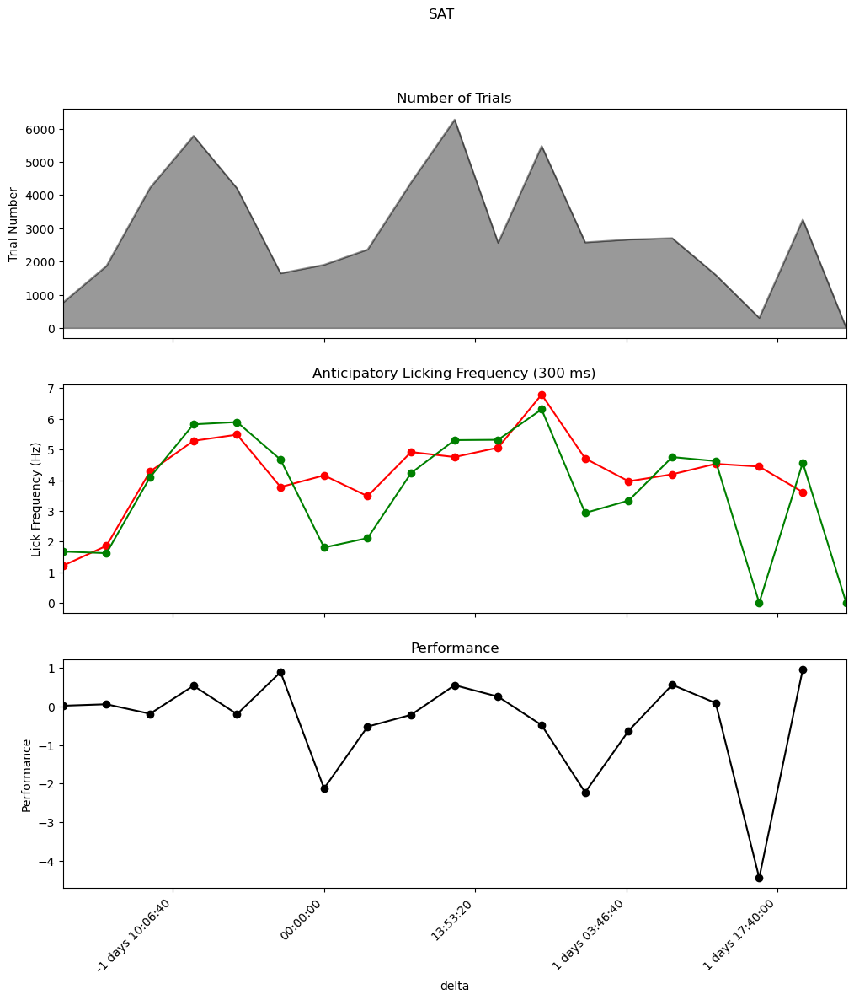

In [ ]:
#plotting with pandas/matplotlib
#plot SAT data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig1, axs1 = plt.subplots(3, 1, sharex=True, figsize=(12, 12))
nt4_plot.loc[:, ("SAT")][["sum"]].plot(style="k", ax=axs1[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs1[0].set_title("Number of Trials")
#i4_plot.loc[:, ("SAT")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs1[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs1[1].set_title("Anticipatory Licking Frequency (300 ms)")
af4_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[1], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[2].set_title("Performance")
af4_plot.loc[:, ("SAT", "perf")].plot(style="ko-", ax=axs1[2], ylabel="Performance", legend=False)
#afl4_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
#axs1[3].set_title("Anticipatory Licking Frequency (500 ms)")
#cf4_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
#axs1[4].set_title("Consummatory Licking Frequency (500 ms)")
fig1.suptitle("SAT")
plt.xticks(rotation=45, ha='right')
'''
#plot SAT_100 data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig2, axs2 = plt.subplots(3, 1, sharex=True, figsize=(12, 12))
nt4_plot.loc[:, ("SAT_100_80")][["sum"]].plot(style="k", ax=axs2[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs2[0].set_title("Number of Trials")
#i4_plot.loc[:, ("SAT_100_80")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs2[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs2[1].set_title("Anticipatory Licking Frequency (300 ms)")
af4_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[1], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[2].set_title("Performance")
af4_plot.loc[:, ("SAT_100_80", "perf")].plot(style="ko-", ax=axs2[2], colormap=cmap, ylabel="Performance", legend=False)
#afl4_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
#axs2[3].set_title("Anticipatory Licking Frequency (500 ms)")
#cf4_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
#axs2[4].set_title("Consummatory Licking Frequency (500 ms)")
fig2.suptitle("100\% 80\% SAT")
plt.xticks(rotation=45, ha='right')

#plot comparsion perf data
cmap = mpl.colors.ListedColormap(["blue", "black"])
fig3, axs3 = plt.subplots(2, 1, sharex=True, figsize=(12, 12))
nt4_plot.loc[:, (slice(None), "sum")].plot(colormap=cmap, ax=axs3[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False, stacked=False)
axs3[0].set_title("Number of Trials")
#i4_plot.loc[:, (slice(None), "sum")].astype("timedelta64[s]").plot(colormap=cmap, stacked=False, ax=axs3[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
#axs3[1].set_title("Intertrial Interval")
af4_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[1], colormap=cmap, ylabel="Performance", legend=False)
axs3[1].set_title("Anticipatory Licking Frequency (300 ms)")
#afl4_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[3], colormap=cmap, ylabel="Performance", legend=False)
#axs3[3].set_title("Anticipatory Licking Frequency (500 ms)")
#cf4_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[4], colormap=cmap, ylabel="Performance", xlabel="Time (Hr)", legend=True)
#axs3[4].set_title("Consummatory Licking Frequency (500 ms)")
fig3.suptitle("Performance Comparison")
plt.xticks(rotation=45, ha='right')

#export figures
#pdf = bp.PdfPages("C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\plots_4H.pdf")
#for fig in range(1, plt.gcf().number + 1):
#    pdf.savefig(fig)
#pdf.close()
'''

### 2H bins

In [ ]:
#analysis (2H bins)
af2 = resample_for_plot(getFreq(animals, -300,0, "2H"), "lick", "2H", perf=True)
afl2 = resample_for_plot(getFreq(animals, -500,0, "2H"), "lick", "2H", perf=True)
cf2 = resample_for_plot(getFreq(animals, 0,500, "2H"), "lick", "2H", perf=True)
i2 = resample_for_plot(getInterval(animals, "2H"), "interval", "2H", sum=True)
nt2 = (getNumTrials(animals, "2H", False))
#plotting
af2_plot = af2.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
afl2_plot = afl2.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cf2_plot = cf2.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
i2_plot = i2.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
nt2_plot = nt2.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cmap = mpl.colors.ListedColormap(["red", "green"])

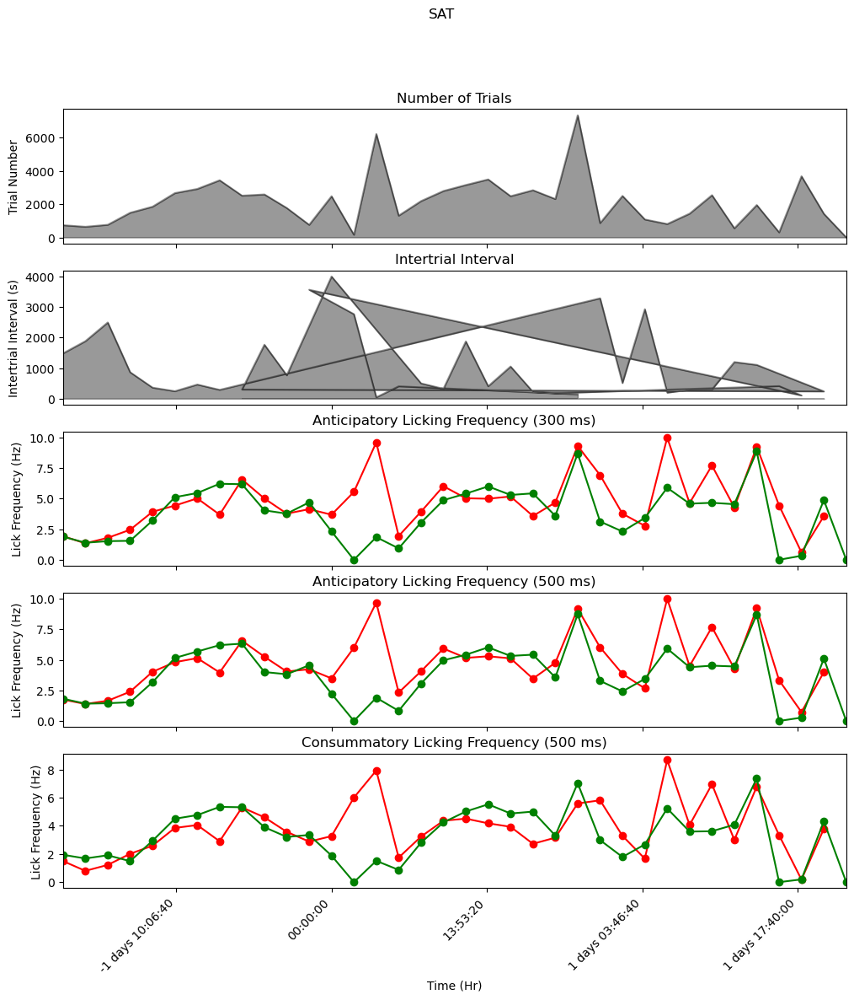

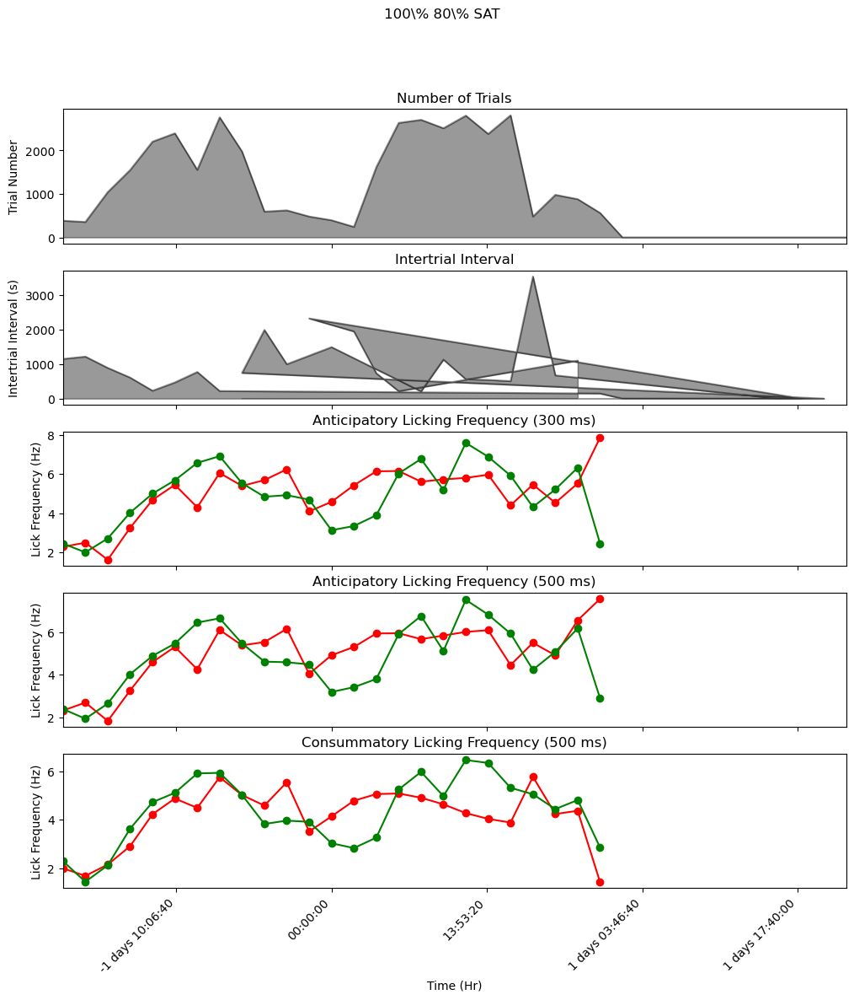

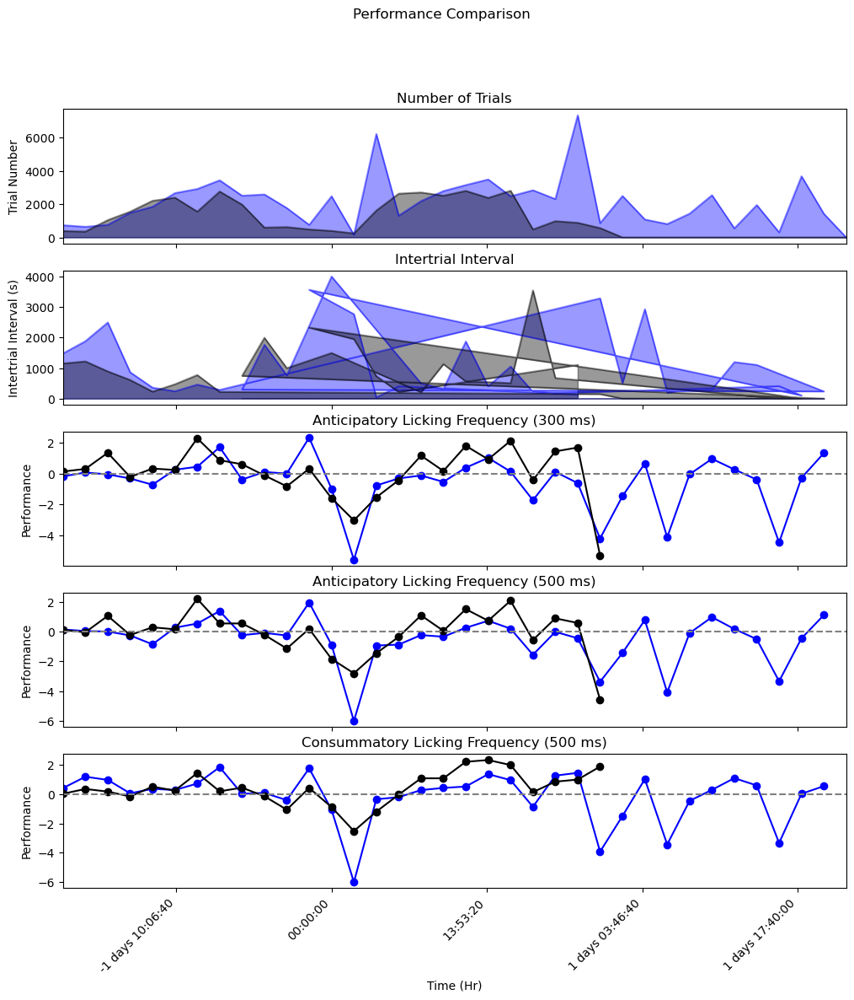

In [ ]:
#plotting with pandas/matplotlib
#plot SAT data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig1, axs1 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt2_plot.loc[:, ("SAT")][["sum"]].plot(style="k", ax=axs1[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs1[0].set_title("Number of Trials")
i2_plot.loc[:, ("SAT")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs1[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs1[1].set_title("Intertrial Interval")
af2_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[2], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl2_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf2_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
axs1[4].set_title("Consummatory Licking Frequency (500 ms)")
fig1.suptitle("SAT")
plt.xticks(rotation=45, ha='right')

#plot SAT_100 data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig2, axs2 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt2_plot.loc[:, ("SAT_100_80")][["sum"]].plot(style="k", ax=axs2[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs2[0].set_title("Number of Trials")
i2_plot.loc[:, ("SAT_100_80")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs2[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs2[1].set_title("Intertrial Interval")
af2_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[2], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs2[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl2_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs2[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf2_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
axs2[4].set_title("Consummatory Licking Frequency (500 ms)")
fig2.suptitle("100\% 80\% SAT")
plt.xticks(rotation=45, ha='right')

#plot comparsion perf data
cmap = mpl.colors.ListedColormap(["blue", "black"])
fig3, axs3 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt2_plot.loc[:, (slice(None), "sum")].plot(colormap=cmap, ax=axs3[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False, stacked=False)
axs3[0].set_title("Number of Trials")
i2_plot.loc[:, (slice(None), "sum")].astype("timedelta64[s]").plot(colormap=cmap, stacked=False, ax=axs3[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs3[1].set_title("Intertrial Interval")
af2_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[2], colormap=cmap, ylabel="Performance", legend=False)
axs3[2].axhline(y=0, color='grey', ls='--')
axs3[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl2_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[3], colormap=cmap, ylabel="Performance", legend=False)
axs3[3].axhline(y=0, color='grey', ls='--')
axs3[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf2_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[4], colormap=cmap, ylabel="Performance", xlabel="Time (Hr)", legend=False)
axs3[4].axhline(y=0, color='grey', ls='--')
axs3[4].set_title("Consummatory Licking Frequency (500 ms)")
fig3.suptitle("Performance Comparison")
plt.xticks(rotation=45, ha='right')

#export figures
pdf = bp.PdfPages("C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\plots_2H.pdf")
for fig in range(1, plt.gcf().number + 1):
    pdf.savefig(fig)
pdf.close()

### 1H bins

In [ ]:
#analysis (1H bins)
af1 = resample_for_plot(getFreq(animals, -300,0, "1H"), "lick", "1H", perf=True)
afl1 = resample_for_plot(getFreq(animals, -500,0, "1H"), "lick", "1H", perf=True)
cf1 = resample_for_plot(getFreq(animals, 0,500, "1H"), "lick", "1H", perf=True)
i1 = resample_for_plot(getInterval(animals, "1H"), "interval", "1H", sum=True)
nt1 = (getNumTrials(animals, "1H", False))
#plotting
af1_plot = af1.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
afl1_plot = afl1.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cf1_plot = cf1.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
i1_plot = i1.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
nt1_plot = nt1.loc[(slice(None), slice(None), slice(None), "mean")].unstack(level=["condition", "trial type"])
cmap = mpl.colors.ListedColormap(["red", "green"])

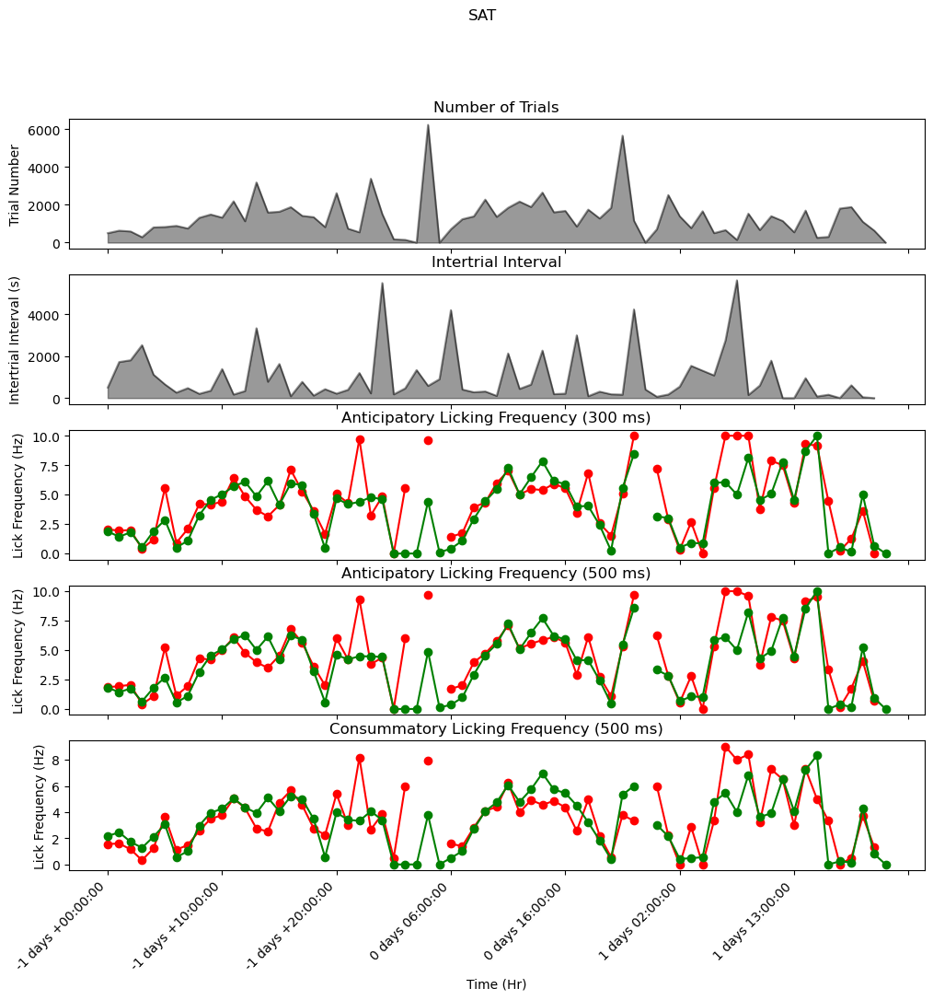

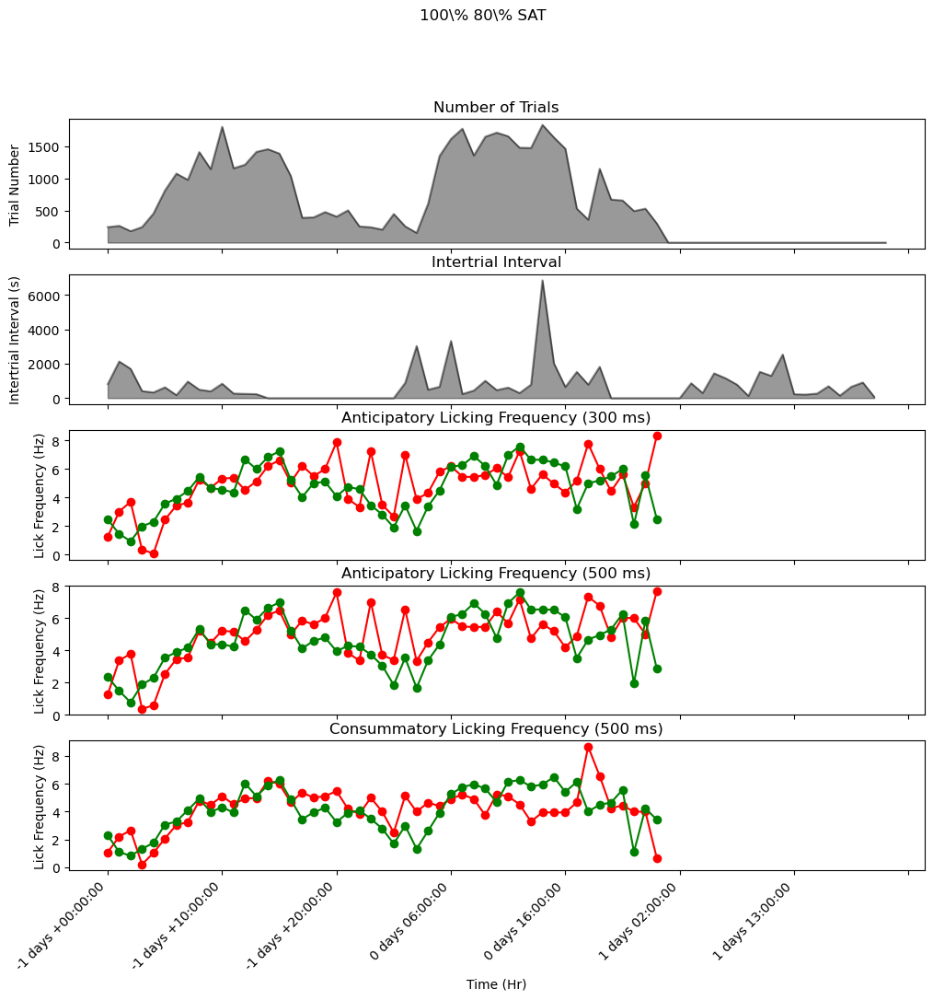

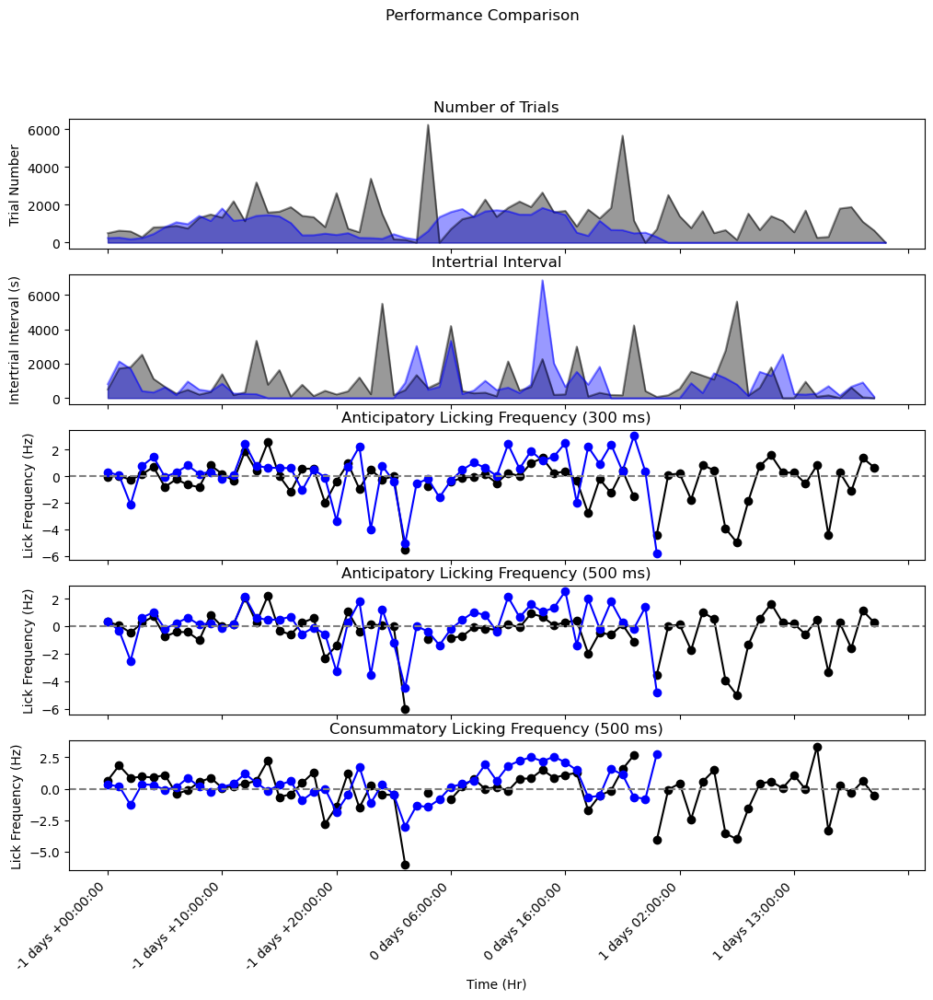

In [ ]:
#plotting with pandas/matplotlib
#plot SAT data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig1, axs1 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt1_plot.loc[:, ("SAT")][["sum"]].plot(style="k", ax=axs1[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs1[0].set_title("Number of Trials")
i1_plot.loc[:, ("SAT")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs1[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs1[1].set_title("Intertrial Interval")
af1_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[2], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl1_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs1[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf1_plot.loc[:, ("SAT")][["blank", "water"]].plot(style="o-", ax=axs1[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
axs1[4].set_title("Consummatory Licking Frequency (500 ms)")
fig1.suptitle("SAT")
plt.xticks(rotation=45, ha='right')

#plot SAT_100 data
cmap = mpl.colors.ListedColormap(["red", "green"])
fig2, axs2 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt1_plot.loc[:, ("SAT_100_80")][["sum"]].plot(style="k", ax=axs2[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False)
axs2[0].set_title("Number of Trials")
i1_plot.loc[:, ("SAT_100_80")][["sum"]].astype("timedelta64[s]").plot(style="k", ax=axs2[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs2[1].set_title("Intertrial Interval")
af1_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[2], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs2[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl1_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs2[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf1_plot.loc[:, ("SAT_100_80")][["blank", "water"]].plot(style="o-", ax=axs2[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
axs2[4].set_title("Consummatory Licking Frequency (500 ms)")
fig2.suptitle("100\% 80\% SAT")
plt.xticks(rotation=45, ha='right')

#plot comparsion perf data
cmap = mpl.colors.ListedColormap(["black", "blue"])
fig3, axs3 = plt.subplots(5, 1, sharex=True, figsize=(12, 12))
nt1_plot.loc[:, (slice(None), "sum")].plot(colormap=cmap, ax=axs3[0], kind="area", alpha=0.4, ylabel="Trial Number", legend=False, stacked=False)
axs3[0].set_title("Number of Trials")
i1_plot.loc[:, (slice(None), "sum")].astype("timedelta64[s]").plot(colormap=cmap, stacked=False, ax=axs3[1], kind="area", alpha=0.4, ylabel="Intertrial Interval (s)", legend=False)
axs3[1].set_title("Intertrial Interval")
af1_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[2], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs3[2].axhline(y=0, color='grey', ls='--')
axs3[2].set_title("Anticipatory Licking Frequency (300 ms)")
afl1_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[3], colormap=cmap, ylabel="Lick Frequency (Hz)", legend=False)
axs3[3].axhline(y=0, color='grey', ls='--')
axs3[3].set_title("Anticipatory Licking Frequency (500 ms)")
cf1_plot.loc[:, (slice(None), "perf")].plot(style="o-", ax=axs3[4], colormap=cmap, ylabel="Lick Frequency (Hz)", xlabel="Time (Hr)", legend=False)
axs3[4].axhline(y=0, color='grey', ls='--')
axs3[4].set_title("Consummatory Licking Frequency (500 ms)")
fig3.suptitle("Performance Comparison")
plt.xticks(rotation=45, ha='right')

#export figures
pdf = bp.PdfPages("C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\plots_1H.pdf")
for fig in range(1, plt.gcf().number + 1):
    pdf.savefig(fig)
pdf.close()

### Seaborn
for quick by-animal plots and mean plots with errorbars

In [ ]:
#plotting with seaborn for by-animal stats
analysis = pd.DataFrame()
analysis["num trials"] = (getNumTrials(animals, "4H", True))
analysis["Anticipatory Licking (300 ms)"] = resample_for_plot(getFreq(animals, -300,0, "4H"), "lick", "4H", sum=True, perf=True)
analysis["Consummatory Licking"] = resample_for_plot(getFreq(animals, 0,500, "4H"), "lick", "4H", sum=True, perf=True)
analysis["Anticipatory Licking (500 ms)"] = resample_for_plot(getFreq(animals, -500,0, "4H"), "lick", "4H", sum=True, perf=True)
analysis["Inter-trial Intervals"] = (resample_for_plot(getInterval(animals, "4H"), "interval", "4H", sum=True)).astype("timedelta64[s]")
analysis = analysis.reset_index()
analysis["delta"] = analysis["delta"].astype("timedelta64[s]").astype("float64")/3600
analysis = analysis.melt(id_vars=["condition", "animal", "delta", "trial type"], value_vars=["num trials", "Inter-trial Intervals", "Anticipatory Licking (300 ms)", "Anticipatory Licking (500 ms)", "Consummatory Licking"])
analysis = analysis[(analysis["animal"] != "mean")] 
al1 = analysis[(analysis["variable"] != "num trials") & (analysis["variable"] != "Inter-trial Intervals")]
al2 = al1[(al1["trial type"] == "blank") | (al1["trial type"] == "water")]
al3 = al1[al1["trial type"] == "perf"]
#blank vs water for both conditions
#sns.relplot(data=al2,kind="line", x="delta", y="value", errorbar=None, hue="trial type", style="trial type", 
#            markers=True, dashes=False, row="condition", col="variable",palette=sns.color_palette(["red", "green"], 2), facet_kws=dict(sharey=False))
#performance comparison
#sns.relplot(data=al3,kind="line", x="delta", y="value", errorbar=None, hue="condition", style="condition", 
#            markers=True, dashes=False, col="variable", palette=sns.color_palette(["blue", "black"], 2), facet_kws=dict(sharey=False))
#with errorbars
#sns.relplot(data=al3,kind="line", x="delta", y="value", hue="condition", style="condition", 
#            markers=True, dashes=False, col="variable", palette=sns.color_palette(["blue", "black"], 2), facet_kws=dict(sharey=False))

#blank vs water by animal
#sns.relplot(data=al2, kind="line", x="delta", y="value", errorbar=None, hue="trial type", style="condition", 
#            markers=False, dashes=True, row="animal", col="variable",palette=sns.color_palette(["red", "green"], 2), facet_kws=dict(sharey=False))
#sns.relplot(data=al2[al2["condition"] == "SAT_100_80"],kind="line", x="delta", y="value", errorbar=None, hue="trial type", style="trial type", 
#            markers=True, dashes=False, row="animal", col="variable",palette=sns.color_palette(["red", "black", "green"], 3), facet_kws=dict(sharey=False))
#performance by animal
#sns.relplot(data=al3, kind="line", x="delta", y="value", errorbar=None, hue="trial type", style="condition", 
#            markers=False, dashes=True, row="animal", col="variable",palette=sns.color_palette(["black"], 1), facet_kws=dict(sharey=False))


#export firgures
#pdf = bp.PdfPages("C:\\Users\\swind\\Documents\\lab work\\lab work barth\\behavior analysis\\seaborn_output.pdf")
#for fig in range(1, plt.gcf().number + 1):
#    pdf.savefig(fig)
#pdf.close()

### Other

In [ ]:
pl = pd.DataFrame()
pl["long"] = i.loc[i["interval"] >= pd.to_timedelta(1, unit="H")]["interval"].groupby("animal").mean()
pl["short"] = i.loc[i["interval"] < pd.to_timedelta(1, unit="H")]["interval"].groupby("animal").mean()
pl["all"] = i["interval"].groupby("animal").mean()
pl2 = resample_for_plot(i.loc[i["interval"] < pd.to_timedelta(1, unit="H")], "interval", "2H", perf=True)
i.loc[("SAT", "GSB8 Caitlyn"), "interval"].astype("timedelta64[s]").plot(logy=True)
pl2.unstack(level=["condition", "trial type", "animal"]).loc[:, (slice(None), "perf", "mean")].astype("timedelta64[s]").plot(legend=False)

df = pd.concat([nt, (resample_for_plot(i, "interval", "2H", sum=True).astype("timedelta64[s]"))], axis=1).rename({0:"count", 1:"interval"}, axis=1)
#df["count"].unstack(level=["condition", "trial type", "animal"]).loc[:, (slice(None), "sum", "mean")].plot()
#df["interval"].unstack(level=["condition", "trial type", "animal"]).loc[:, (slice(None), "sum", "mean")].plot()
df["count"].unstack(level=["condition", "trial type", "animal"]).loc[:, (slice(None), "sum", "mean")]

df.loc[(slice(None), slice(None), "sum", "mean"), :].unstack(level=["condition", "trial type"]).loc[:, (slice(None),"SAT")].plot(colormap="rainbow")
df.loc[(slice(None), slice(None), "sum", "mean"), :].unstack(level=["condition", "trial type"]).loc[:, (slice(None),"SAT")]
resample_for_plot(i, "interval", "2H", sum=True).unstack(level=["condition", "trial type", "animal"]).loc[:, ("SAT", "sum")]

NameError: name 'i' is not defined

## Does the identity of a previous trial change the behaivior of the current trial?



Variables
1. anticapatory licking
1. consummatory licking
1. identity of
    1. current trial
    1. previous trial
    1. 2-back trial
    1. etc.
1. number of trials that fall into each identity bin
1. licking behavior for each identity bin
1. time

In [ ]:
#previous trial proportions and ant lick freq
t_type = animals.groupby(["condition", "animal", "trial no"])["trial type"].first()
p_trial = pd.DataFrame()
p_trial["curr"] = t_type
p_trial["1 back"] = t_type.shift(1)
p_trial["2 back"] = t_type.shift(2)
#prev trial was water
ww = (p_trial["curr"] == "water") & (p_trial["1 back"] == "water")
bw = (p_trial["curr"] == "water") & (p_trial["1 back"] == "blank")
b2w = (p_trial["curr"] == "water") & (p_trial["1 back"] == "blank") & (p_trial["2 back"] == "blank")
w2w = (p_trial["curr"] == "water") & (p_trial["1 back"] == "water") & (p_trial["2 back"] == "water")
#ww_af = getFreq(animals[ww], -300,0, "4H")
#bw_af = getFreq(animals[bw], -300,0, "4H")
#b2w_af = getFreq(animals[b2w], -300,0, "4H")
#w2w_af = getFreq(animals[w2w], -300, 0, "4H")
#af = getFreq(animals, -300,0, "4H")

it = getInterval(animals, "4H")
ww_it = getInterval(animals[ww], "4H")
bw_it = getInterval(animals[bw], "4H")
b2w_it = getInterval(animals[b2w], "4H")
w2w_it = getInterval(animals[w2w], "4H")

water_loc = ("SAT", "water", slice(None), "mean")
#df = pd.concat([w2w_it.loc[water_loc][1:], ww_it.loc[water_loc][1:],it.loc[water_loc][1:], bw_it.loc[water_loc][1:], b2w_it.loc[water_loc][1:]], axis=1).rename({0:"w2w", 1:"ww", 3:"bw", 4:"b2w", 2:"all"}, axis=1)
df = pd.concat([ww_it.loc[water_loc][1:],it.loc[water_loc][1:], bw_it.loc[water_loc][1:]], axis=1).rename({0:"ww", 2:"bw", 1:"all"}, axis=1)
#fig, axs = plt.subplots(2, 2, sharex=True, figsize=(12,6))
df.plot(style="o-", colormap="Accent", layout="constrained", sharex=False, sharey=False)
nt.loc[:, ("SAT", "mean")].plot(secondary_y=True, style="k", kind="area", alpha=0.2)
plt.xticks(rotation=45, ha='right')

'''
df.loc[:, "w2w":"all"].plot(style="o-", colormap="Accent", layout="constrained", ax=axs[0][1], sharex=False, sharey=False)
df.loc[:, "bw":"b2w"].plot(style="o-", colormap="Accent", layout="constrained", ax=axs[1][1], sharex=False, sharey=False)
axs[0][0].set_ylabel("lick frequency (Hz)")
axs[0][1].set_ylabel("lick frequency (Hz)")
axs[1][1].set_ylabel("lick frequency (Hz)")
axs[1][0].set_xlabel("Time (Hr)")
axs[1][1].set_xlabel("Time (Hr)")
axs[1][0].set_ylabel("Performance")

#df.sub(af.loc[("SAT", "blank", slice(None), "mean")], axis=0).plot(style="o-", colormap="Accent", layout="constrained", ax=axs[1][0], sharex=False, sharey=False, legend=False)
'''

## General Analysis: Are there measures or approaches of interest that we are not considering?



Measures:
1. expand or move anticipatory window
1. consummatory licking (after water delivery)
1. inter-trial intervals

Approaches:
1. binning trials based on inter-trial intervals rather than timebins
1. rolling window approach

~~plot licking curves at early, late timepoints? -> rolling window for frequeny across entire trial, choose boundaries for early, late~~

~~(maybe average licking curve for each 4H bin?, performance?)~~

How soon after stim do mice start licking to stimulus trials more than to blank trials? 
- quantify across 4h bins

How long after air is turned on does it take for mice to lick more to stimulus than to blank trials? 
- analyze licking in x ms bins continuously from air start
- look at each bin separately

In [404]:
animals=all_animals

#### Functions for analysis

In [397]:
def freqCurve(data, freq_bin, trial_bin):
    '''
    Returns lick frequency resampled by given frequency and binned into given trial bin size.
    Arguments:
    data - data to resample
    freq_bin - size of bin to calculate lick and poke frequency with, in ms
    trial_bin - size of bin to group trials by, in H
    '''
    #find start of water delivery (trial start + delay to puff + 1s)
    grouped = data.groupby(["condition", "animal", "trial no"])
    data["air start"] = grouped["timestamp"].first() + grouped["delay"].first() #+ pd.to_timedelta("1s")
    data["delivery delta"]  = data["timestamp"] - data["air start"]
    data = data.reset_index().set_index("timestamp")
    #freq window for a frequency across entire trial
    #licks are 1 if lick an 0 if no lick, sum licks over freq window and divide by window size
    licks = data.groupby(["condition", "animal", "trial no", "trial type", pd.Grouper(key="delivery delta", freq=pd.offsets.Milli(freq_bin))])[["lick", "poke"]].sum()/(freq_bin/1000)

    #start of trial across all samples in trial, for by-trial resampling
    licks["trial time"] = data.reset_index().groupby(["condition", "animal", "trial no"])["timestamp"].first()
    licks["SAT_start"] = data.reset_index().groupby(["condition", "animal", "trial no"])["SAT_start"].first()

    #resamples trial time into bins, leaving other columns/index alone (easiest to do this way to maintain alignment of columns)
    #in particular does not effect lick frequency or delivery delta calculations
    licks = licks.reset_index().groupby(["condition", "animal", "trial no", "trial type", "delivery delta", pd.Grouper(key="trial time", freq=pd.offsets.Hour(trial_bin))]).first()
    licks = licks.reset_index().set_index("animal")
    return licks

In [398]:
def performance(licks, min_trials):
    '''Drops trial bins with fewer than min_trials blank or water trials and calculates performance for the remaining bins.'''
    acc = licks.groupby(["condition", "animal"]).first()["SAT_start"]
    lk_group = licks.groupby(["condition", "animal", "delivery delta", "trial time", "trial type"])
    #mean lick/poke frequency and trial counts for each bin
    licks = lk_group[["lick", "poke"]].mean().unstack(level="trial type")
    counts = lk_group.count().unstack(level="trial type")

    cond = (counts.loc[:, ("trial no", "blank")] > min_trials) & (counts.loc[:, ("trial no", "water")] > min_trials) 
    licks = licks[cond]

    #calculate performance (water - blank) for licks
    licks.loc[:, ("lick", "perf")] = licks.loc[:, ("lick", "water")] - licks.loc[:,("lick", "blank")]
    #for pokes
    licks.loc[:, ("poke", "perf")] = licks.loc[:, ("poke", "water")] - licks.loc[:,("poke", "blank")]
    licks = licks.stack(level="trial type").reset_index().set_index(["condition", "animal"])
    licks["SAT_start"] = acc
    return licks

In [399]:
def threshold_for_plot(data, curve_start, curve_end):
    #align times to start of air/1 day after initiation of trials
    data = data[(data["delivery delta"] <= pd.to_timedelta(curve_end)) & (data["delivery delta"] >= -pd.to_timedelta(curve_start))]
    data.loc[:,"delivery delta"] = data.loc[:,"delivery delta"].astype("timedelta64[ms]")
    delta = data["trial time"] - data.sort_values("trial time").groupby("animal")["SAT_start"].first()
    data["delta"] = delta.astype("timedelta64[h]")
    return data

In [400]:
def tweakplot(g, ymin, ymax):
    g.set_xlabels("Time (ms)")
    g.set_ylabels("Performance")
    g._legend.set_title("Time (Hr)")
    for ax in g.axes.flat:
        ax.axvline(x=0, ymin=0, ymax=1, ls="--", color="lightgrey", zorder=0)
        ax.axvline(x=1000, ymin=0, ymax=1, ls="--", color="navy", alpha=0.5, zorder=0)
        ax.axhline(y=0, xmin=0, xmax=1, ls="-", lw=0.75,color="black", zorder=0)
        ax.set_ylim(ymin, ymax)

#### Performance over 4H bins

Summary: 100% water animals seem to learn the task earlier and respond to the stimulus sooner than 80% water animals

In [401]:
freq3004 = freqCurve(all_animals, 300, 4)
freq1004 = freqCurve(all_animals, 100, 4)
freq3004

,condition,trial no,trial type,delivery delta,trial time,lick,poke,SAT_start
animal,,,,,,,,
GKO6,SAT,1,water,-1 days +23:59:59.200000,2019-05-01 12:00:00,0.000000,3.333333,2019-05-03 12:25:00
GKO6,SAT,1,water,-1 days +23:59:59.500000,2019-05-01 12:00:00,0.000000,0.000000,2019-05-03 12:25:00
GKO6,SAT,1,water,-1 days +23:59:59.800000,2019-05-01 12:00:00,0.000000,0.000000,2019-05-03 12:25:00
GKO6,SAT,1,water,0 days 00:00:00.100000,2019-05-01 12:00:00,0.000000,0.000000,2019-05-03 12:25:00
GKO6,SAT,1,water,0 days 00:00:00.400000,2019-05-01 12:00:00,0.000000,6.666667,2019-05-03 12:25:00
...,...,...,...,...,...,...,...,...
NIO16,mcherry,705,water,0 days 00:00:02.500000,2022-12-09 12:00:00,3.333333,10.000000,2022-12-08 12:00:00
NIO16,mcherry,705,water,0 days 00:00:02.800000,2022-12-09 12:00:00,3.333333,10.000000,2022-12-08 12:00:00
NIO16,mcherry,705,water,0 days 00:00:03.100000,2022-12-09 12:00:00,3.333333,10.000000,2022-12-08 12:00:00


In [402]:
pf3004 = performance(freq3004, 0)
pf1004 = performance(freq1004, 0)
pf3004

delivery delta          trial time trial type  \
condition animal                                                           
SAT       GKO6   -1 days +23:59:59.200000 2019-05-01 16:00:00      blank   
          GKO6   -1 days +23:59:59.200000 2019-05-01 16:00:00       perf   
          GKO6   -1 days +23:59:59.200000 2019-05-01 16:00:00      water   
          GKO6   -1 days +23:59:59.200000 2019-05-01 20:00:00      blank   
          GKO6   -1 days +23:59:59.200000 2019-05-01 20:00:00       perf   
...                                   ...                 ...        ...   
mcherry   NIO16    0 days 00:00:04.900000 2022-12-08 20:00:00       perf   
          NIO16    0 days 00:00:04.900000 2022-12-08 20:00:00      water   
          NIO16    0 days 00:00:05.200000 2022-12-08 20:00:00      blank   
          NIO16    0 days 00:00:05.200000 2022-12-08 20:00:00       perf   
          NIO16    0 days 00:00:05.200000 2022-12-08 20:00:00      water   

                      lick      poke           SAT_start  
condition animal                                          
SAT       GKO6    0.000000  5.000000 2019-05-03 12:25:00  
          GKO6    0.000000 -1.666667 2019-05-03 12:25:00  
          GKO6    0.000000  3.333333 2019-05-03 12:25:00  
          GKO6    4.666667  5.333333 2019-05-03 12:25:00  
          GKO6    0.690476 -0.452381 2019-05-03 12:25:00  
...                    ...       ...                 ...  
mcherry   NIO16   0.000000 -2.222222 2022-12-08 12:00:00  
          NIO16   6.666667  7.777778 2022-12-08 12:00:00  
          NIO16   0.000000  6.666667 2022-12-08 12:00:00  
          NIO16   6.666667  1.666667 2022-12-08 12:00:00  
          NIO16   6.666667  8.333333 2022-12-08 12:00:00  

[28641 rows x 6 columns]

In [394]:
#300ms frequency calculation, 4H bins, no dropped bins
plot3004 = threshold_for_plot(pf3004, "2s", "3s")
plot3004 = plot3004[(plot3004["delta"] < 24) & (plot3004["delta"] > -24)]
plot3004 = plot3004.reset_index().set_index("animal")
perf3004 = plot3004[plot3004["trial type"] == "perf"]
lickfreq3004 = plot3004[(plot3004["trial type"] == "water") | (plot3004["trial type"] == "blank")]

plot1004 = threshold_for_plot(pf1004, "2s", "3s")
plot1004 = plot1004[(plot1004["delta"] < 24) & (plot1004["delta"] > -24)]
plot1004 = plot1004.reset_index().set_index("animal")
perf1004 = plot1004[plot1004["trial type"] == "perf"]
lickfreq1004 = plot1004[(plot1004["trial type"] == "water") | (plot1004["trial type"] == "blank")]

perf3004["delta"].unique()

C:\Users\swind\AppData\Local\Temp\ipykernel_11516\1535500458.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:,"delivery delta"] = data.loc[:,"delivery delta"].astype("timedelta64[ms]")
C:\Users\swind\AppData\Local\Temp\ipykernel_11516\1535500458.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["delta"] = delta.astype("timedelta64[h]")
C:\Users\swind\AppData\Local\Temp\ipykernel_11516\1535500458.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

array([-20., -16., -12.,   0.,   4.,   8.,  -4.,  16.,  20.,  12.,  -8.])

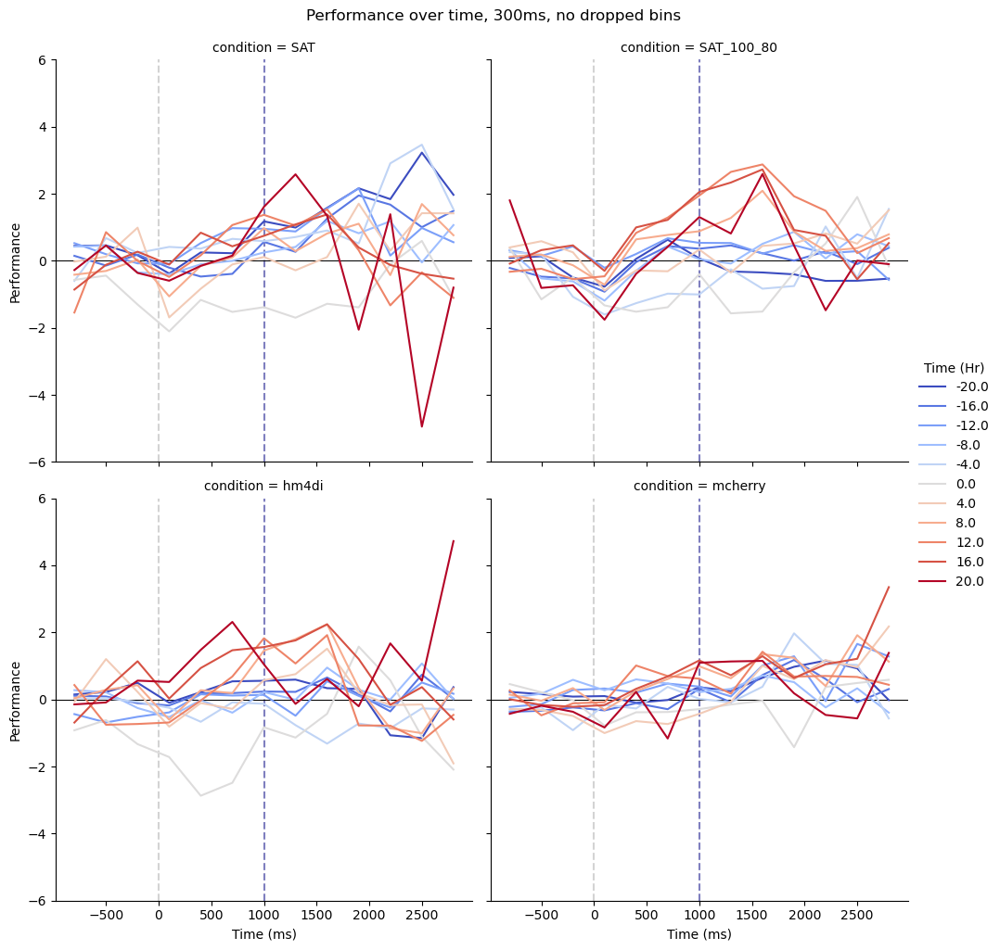

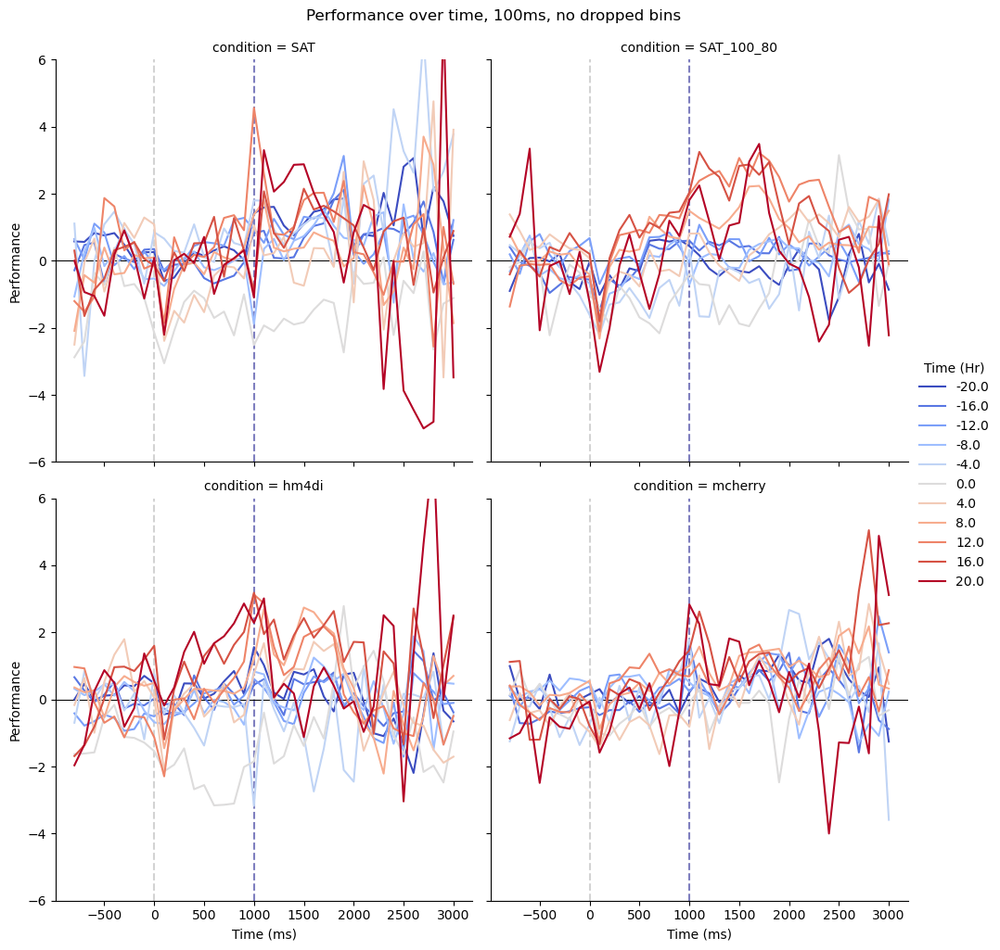

In [ ]:
#plot performance by condition, all bins
#g = sns.relplot(data=perf,kind="line",x="delivery delta", y="lick",col="condition", hue="delta", palette="coolwarm", errorbar="se", err_style="bars",legend="full")
g = sns.relplot(data=perf3004,kind="line",x="delivery delta", y="lick",col="condition", col_wrap=2,hue="delta", palette="coolwarm", errorbar=None,legend="full")
#g.axes[0][0].set_title("80% water")
#g.axes[0][1].set_title("100% water")
g.fig.suptitle("Performance over time, 300ms, no dropped bins", y=1.02)
tweakplot(g,-6, 6)

g = sns.relplot(data=perf1004,kind="line",x="delivery delta", y="lick",col="condition", col_wrap=2,hue="delta", palette="coolwarm", errorbar=None,legend="full")
#g.axes[0][0].set_title("80% water")
#g.axes[0][1].set_title("100% water")
g.fig.suptitle("Performance over time, 100ms, no dropped bins", y=1.02)
tweakplot(g, -6, 6)

TypeError: tweakplot() missing 2 required positional arguments: 'ymin' and 'ymax'

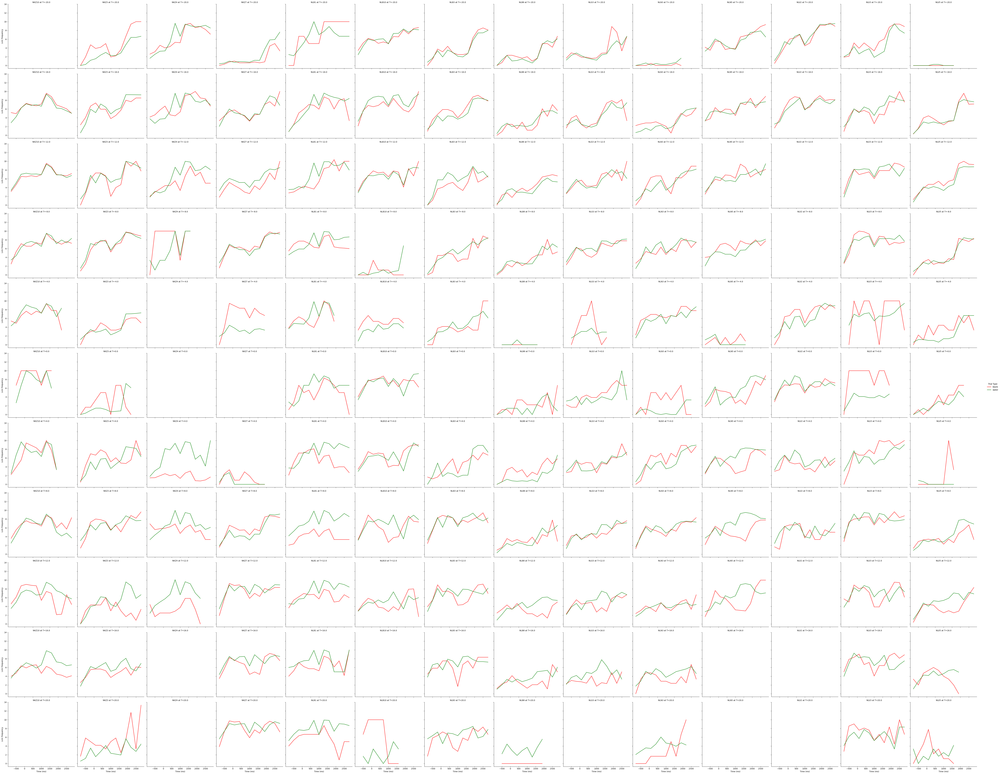

In [ ]:
#plot SAT100 water vs blank by animal and timebin
g2 = sns.relplot(data=lickfreq3004[(lickfreq3004["condition"] == "SAT_100_80")],kind="line",x="delivery delta", y="lick",col="animal", row="delta",hue="trial type", 
            palette=["red", "green"], errorbar=None)
g2.set_xlabels("Time (ms)")
g2.set_ylabels("Lick Frequency")
g2._legend.set_title("Trial Type")
g2.set_titles("{col_name} at T={row_name}")
tweakplot(g2)
g2.fig.suptitle("Water vs Blank, 300ms resample, 100% water", y=1.02)

Text(0.5, 1.02, 'Water vs Blank, 300ms resample, 80% water')

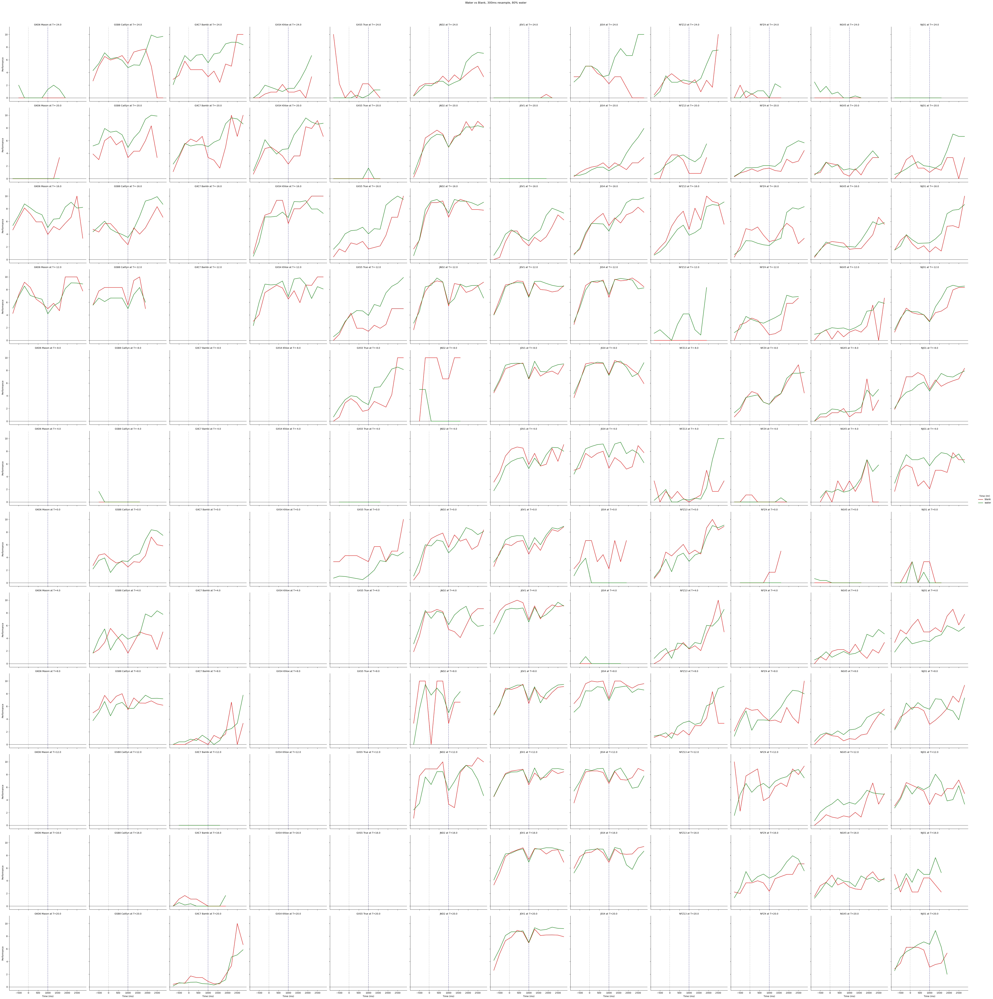

In [ ]:
#plot SAT80 water vs blank 
#sns.relplot(data=pt[pt["condition"] == "SAT"],kind="line",x="delivery delta", y="lick",col="animal", hue="delta", palette="viridis_r",facet_kws=dict(sharex=False, sharey=False))
g3 = sns.relplot(data=lickfreq3004[(lickfreq3004["condition"] == "SAT")],kind="line",x="delivery delta", y="lick",col="animal", row="delta",hue="trial type", 
            palette=["red", "green"], errorbar=None)
g3.set_xlabels("Time (ms)")
g3.set_ylabels("Lick Frequency")
g3._legend.set_title("Trial Type")
g3.set_titles("{col_name} at T={row_name}")
tweakplot(g3)
g3.fig.suptitle("Water vs Blank, 300ms resample, 80% water", y=1.02)

Text(0.5, 1.02, 'Water vs Blank, 300ms resample, hm4di')

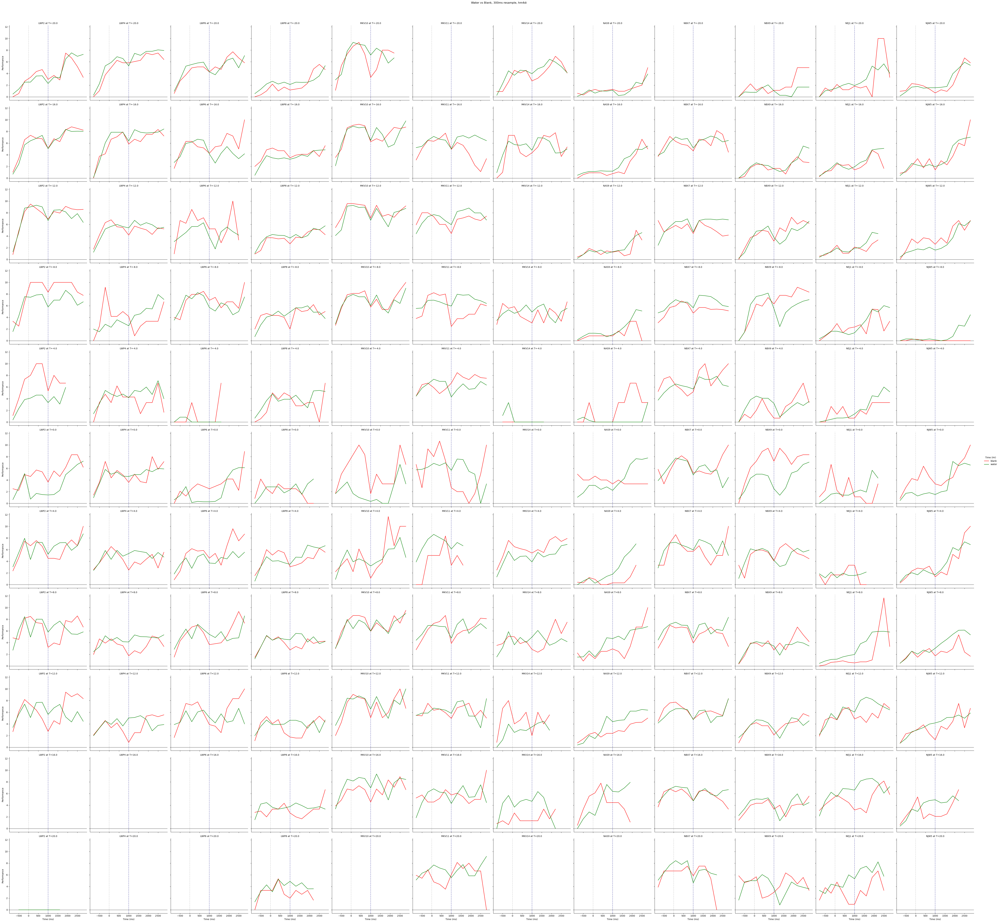

In [ ]:
#plot hM4Di water vs blank 
#sns.relplot(data=pt[pt["condition"] == "SAT"],kind="line",x="delivery delta", y="lick",col="animal", hue="delta", palette="viridis_r",facet_kws=dict(sharex=False, sharey=False))
g3 = sns.relplot(data=lickfreq3004[(lickfreq3004["condition"] == "hm4di")],kind="line",x="delivery delta", y="lick",col="animal", row="delta",hue="trial type", 
            palette=["red", "green"], errorbar=None)
g3.set_xlabels("Time (ms)")
g3.set_ylabels("Lick Frequency")
g3._legend.set_title("Trial Type")
g3.set_titles("{col_name} at T={row_name}")
tweakplot(g3)
g3.fig.suptitle("Water vs Blank, 300ms resample, hm4di", y=1.02)

Text(0.5, 1.02, 'Water vs Blank, 300ms resample, mCherry')

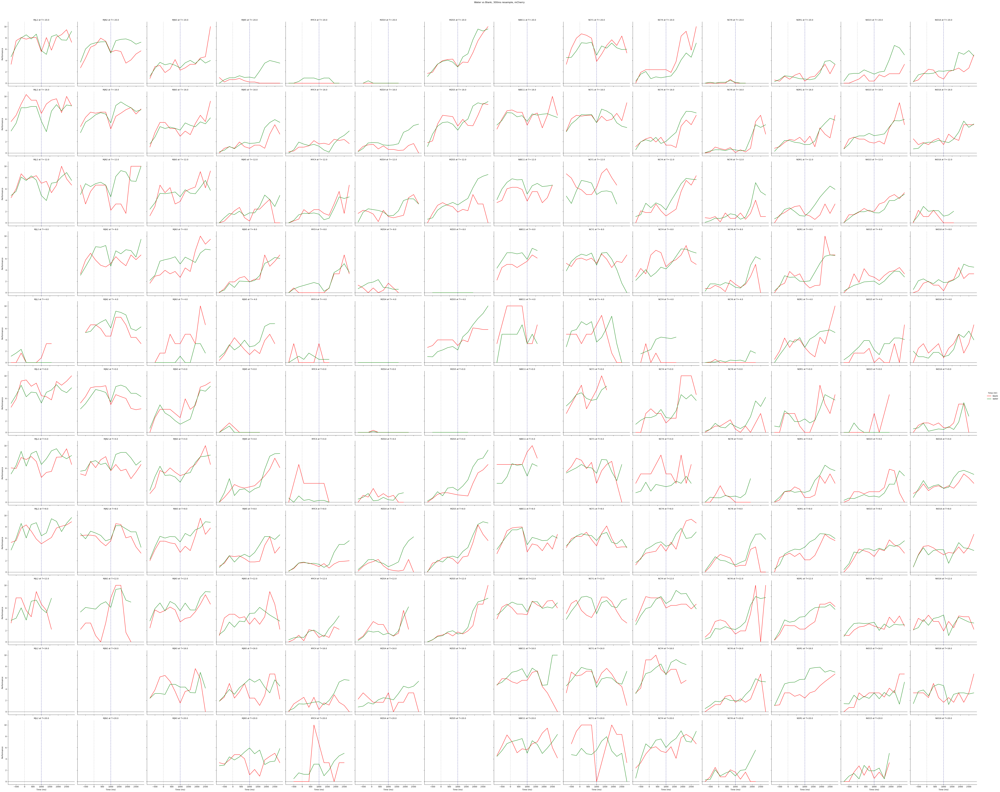

In [ ]:
#plot mCherry water vs blank 
#sns.relplot(data=pt[pt["condition"] == "SAT"],kind="line",x="delivery delta", y="lick",col="animal", hue="delta", palette="viridis_r",facet_kws=dict(sharex=False, sharey=False))
g3 = sns.relplot(data=lickfreq3004[(lickfreq3004["condition"] == "mcherry")],kind="line",x="delivery delta", y="lick",col="animal", row="delta",hue="trial type", 
            palette=["red", "green"], errorbar=None)
g3.set_xlabels("Time (ms)")
g3.set_ylabels("Lick Frequency")
g3._legend.set_title("Trial Type")
g3.set_titles("{col_name} at T={row_name}")
tweakplot(g3)
g3.fig.suptitle("Water vs Blank, 300ms resample, mCherry", y=1.02)

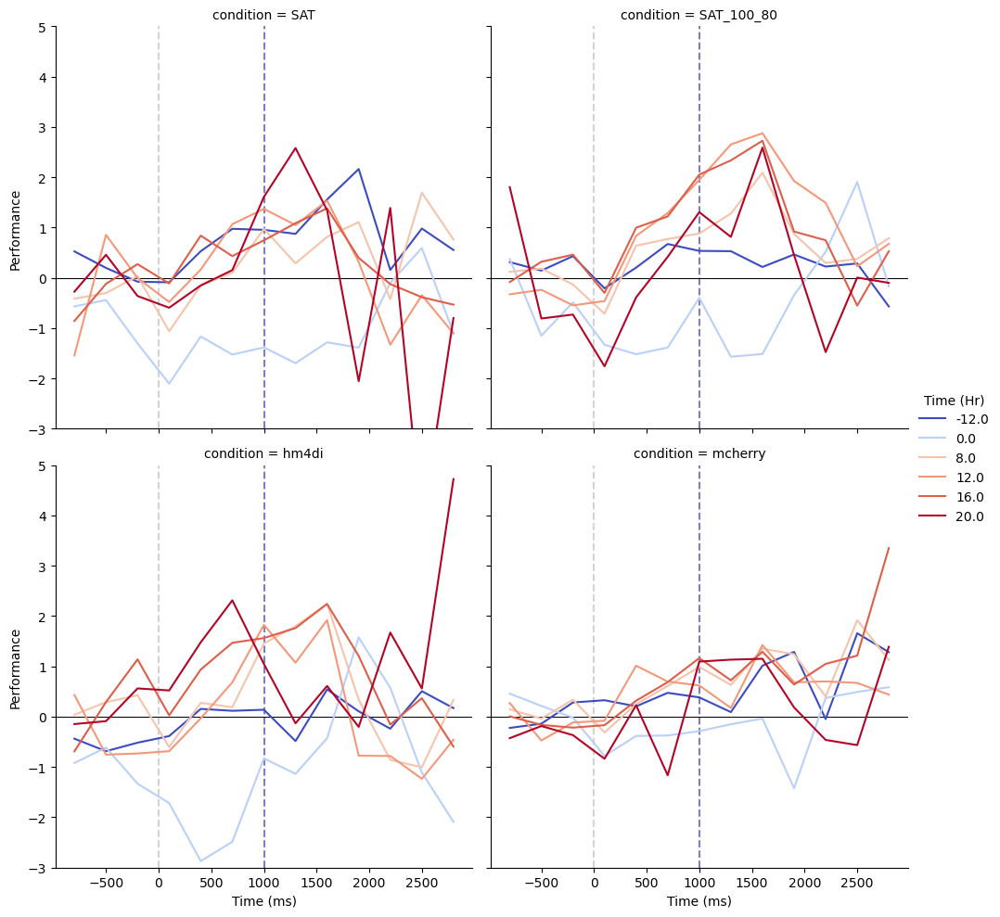

In [ ]:
#4h bins, just at -12h, 0h, +12h, +16, +20
cond3004 = (perf3004["delta"] == -12) | (perf3004["delta"] == 0) | ((perf3004["delta"] >= 8) & (perf3004["delta"] < 24))

#plot performance by condition
g = sns.relplot(data=perf3004[cond3004],kind="line",x="delivery delta", y="lick",col="condition", col_wrap=2,hue="delta", palette="coolwarm", errorbar=None, legend="full")
#g.axes[0][0].set_title("80% water")
#g.axes[0][1].set_title("100% water")
tweakplot(g, -3, 5)

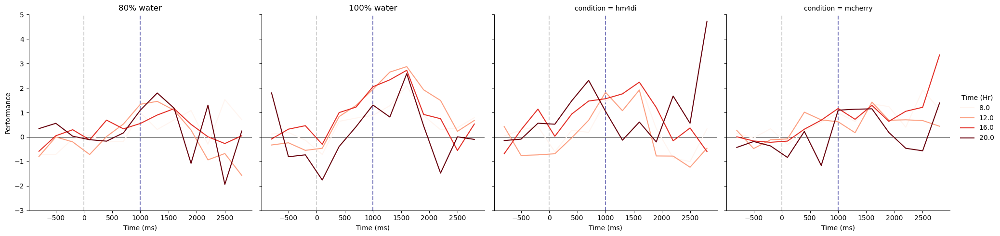

In [ ]:
#just 8h, 12h, 16h, 20h
cond = ((perf["delta"] >= 8) & (perf["delta"] < 24))

#plot performance by condition
g = sns.relplot(data=perf[cond],kind="line",x="delivery delta", y="lick",col="condition", hue="delta", palette="Reds", errorbar=None, legend="full")
g.axes[0][0].set_title("80% water")
g.axes[0][1].set_title("100% water")
tweakplot(g, -3, 5)

In [ ]:
early = plot3004[plot3004["delta"] < 0].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
early["time"] = "acclimation"
mid = plot3004[(plot3004["delta"] >= 0) & (plot3004["delta"] < 8)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
second8 = plot3004[(plot3004["delta"] >= 8) & (plot3004["delta"] < 16)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
third8 = plot3004[(plot3004["delta"] >= 16) & (plot3004["delta"] < 24)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
day2 = plot3004[plot3004["delta"] >= 24].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
mid["time"] = "SAT 0-8h"
second8["time"] = "SAT 8-16h"
third8["time"] = "SAT 16-24h"
plot2 = pd.concat([early, mid, second8, third8])

early = plot1004[plot1004["delta"] < 0].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
early["time"] = "acclimation"
mid = plot1004[(plot1004["delta"] >= 0) & (plot1004["delta"] < 8)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
second8 = plot1004[(plot1004["delta"] >= 8) & (plot1004["delta"] < 16)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
third8 = plot1004[(plot1004["delta"] >= 16) & (plot1004["delta"] < 24)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
day2 = plot1004[plot1004["delta"] >= 24].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
mid["time"] = "SAT 0-8h"
second8["time"] = "SAT 8-16h"
third8["time"] = "SAT 16-24h"
plot3 = pd.concat([early, mid, second8, third8])

C:\Users\swind\AppData\Local\Temp\ipykernel_10856\3087369567.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  early = plot3004[plot3004["delta"] < 0].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
C:\Users\swind\AppData\Local\Temp\ipykernel_10856\3087369567.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mid = plot3004[(plot3004["delta"] >= 0) & (plot3004["delta"] < 8)].groupby(["condition", "animal", "delivery delta", "trial type"]).mean().reset_index()
C:\Users\swind\AppData\Local\Temp\ipykernel_10856\3087369567.py:4: FutureWarning: The default value of numeri

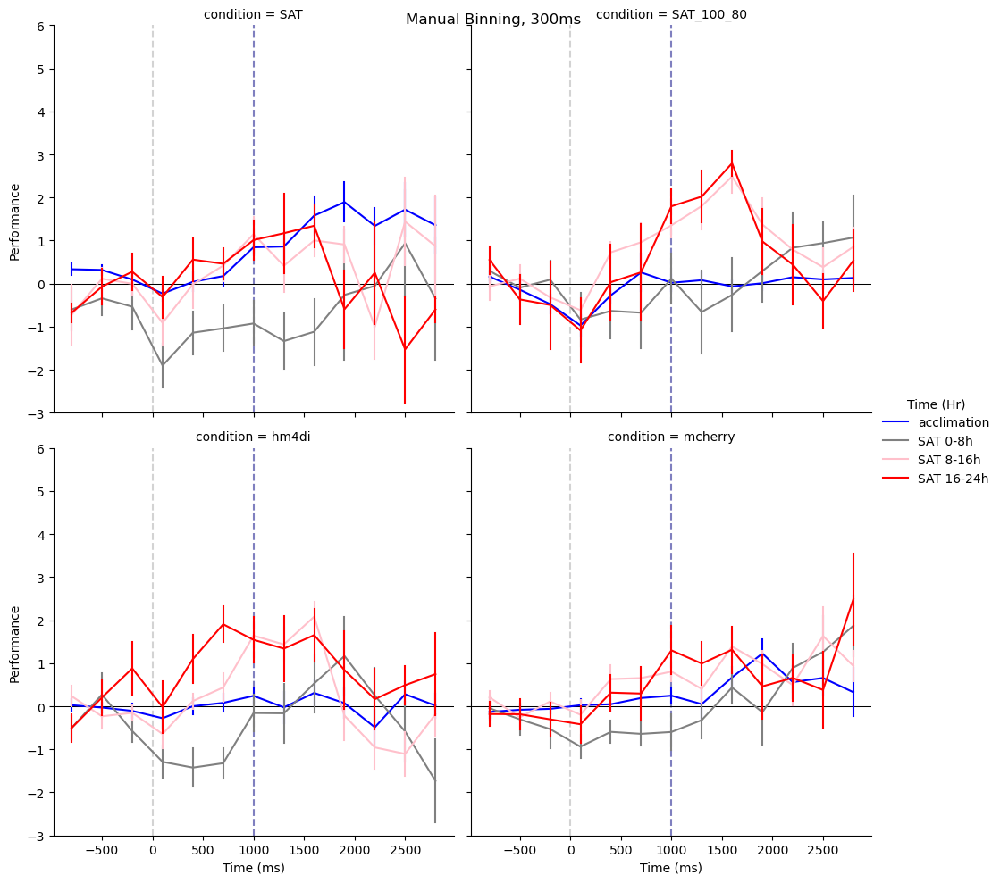

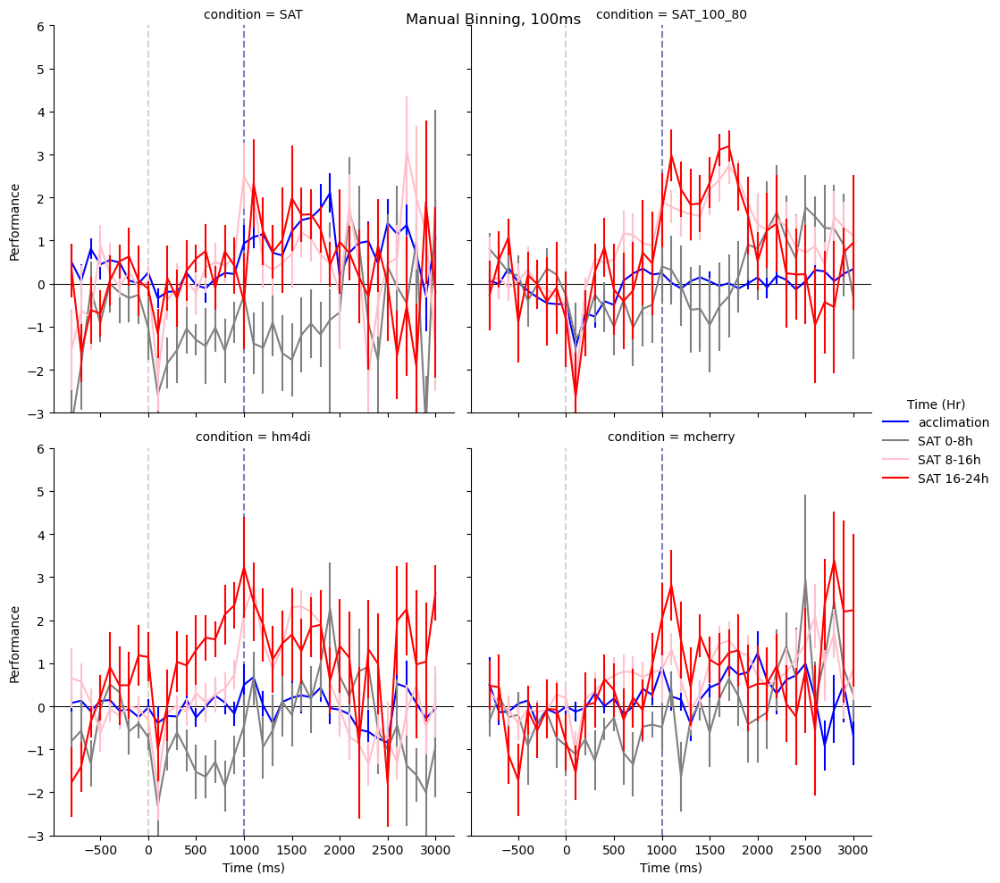

In [ ]:
#manual binning
g = sns.relplot(data=plot2[plot2["trial type"] == "perf"],kind="line",x="delivery delta", y="lick",col="condition",hue="time", 
                palette=["blue", "grey", "pink", "red"], col_wrap=2,errorbar="se", err_style="bars")
#g.axes[0][0].set_title("80% water")
#g.axes[0][1].set_title("100% water")
g.fig.suptitle("Manual Binning, 300ms")
tweakplot(g, -3, 6)

#manual binning
g = sns.relplot(data=plot3[plot3["trial type"] == "perf"],kind="line",x="delivery delta", y="lick",col="condition",hue="time", 
                palette=["blue", "grey", "pink", "red"], col_wrap=2,errorbar="se", err_style="bars")
#g.axes[0][0].set_title("80% water")
#g.axes[0][1].set_title("100% water")
g.fig.suptitle("Manual Binning, 100ms")
tweakplot(g, -3, 6)

TypeError: tweakplot() missing 2 required positional arguments: 'ymin' and 'ymax'

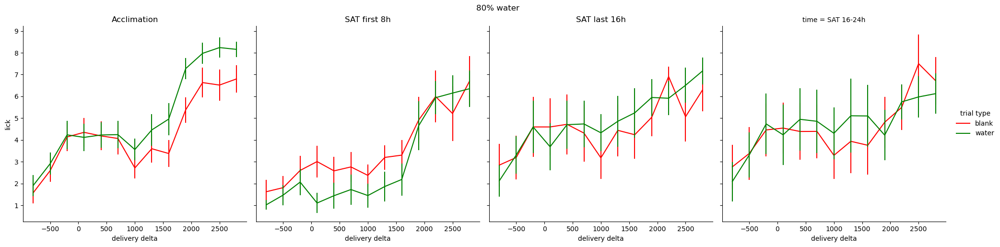

In [ ]:
#licking to blank and water manual timebins
lickfreq2 = plot2[plot2["trial type"] != "perf"] 
g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="time", errorbar="se", err_style="bars")
g.axes[0][0].set_title("Acclimation")
g.axes[0][1].set_title("SAT first 8h")
g.axes[0][2].set_title("SAT last 16h")
g.fig.suptitle("80% water", y=1.02)
tweakplot(g)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT_100_80"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="time", errorbar="se", err_style="bars")
g.axes[0][0].set_title("Acclimation")
g.axes[0][1].set_title("SAT first 8h")
g.axes[0][2].set_title("SAT last 16h")
g.fig.suptitle("100% water", y=1.02)
tweakplot(g)


In [437]:
all_animals


timestamp  poke  lick  water  \
condition  animal trial no                                                    
SAT        GKO6   1        2019-05-01 12:37:04.849999872     1     0      3   
                  1        2019-05-01 12:37:04.950000128     0     0      3   
                  1        2019-05-01 12:37:05.049999872     0     0      3   
                  1        2019-05-01 12:37:05.150000128     0     0      3   
                  1        2019-05-01 12:37:05.249999872     0     0      3   
...                                                  ...   ...   ...    ...   
SAT_100_80 NLV5   712      2023-01-02 11:38:52.980000000     0     0      9   
                  712      2023-01-02 11:38:53.069999872     0     0      9   
                  712      2023-01-02 11:38:53.180000000     0     0      9   
                  712      2023-01-02 11:38:53.280000000     0     0      9   
                  712      2023-01-02 11:38:53.280000000     0     0      7   

                                            delay trial type   age sex  \
condition  animal trial no                                               
SAT        GKO6   1        0 days 00:00:00.696000      water  31.0   M   
                  1        0 days 00:00:00.696000      water  31.0   M   
                  1        0 days 00:00:00.696000      water  31.0   M   
                  1        0 days 00:00:00.696000      water  31.0   M   
                  1        0 days 00:00:00.696000      water  31.0   M   
...                                           ...        ...   ...  ..   
SAT_100_80 NLV5   712             0 days 00:00:00      blank  25.0   F   
                  712             0 days 00:00:00      blank  25.0   F   
                  712             0 days 00:00:00      blank  25.0   F   
                  712             0 days 00:00:00      blank  25.0   F   
                  712             0 days 00:00:00      blank  25.0   F   

                                  strain           SAT_start  
condition  animal trial no                                    
SAT        GKO6   1         Sscre x Ai32 2019-05-03 12:25:00  
                  1         Sscre x Ai32 2019-05-03 12:25:00  
                  1         Sscre x Ai32 2019-05-03 12:25:00  
                  1         Sscre x Ai32 2019-05-03 12:25:00  
                  1         Sscre x Ai32 2019-05-03 12:25:00  
...                                  ...                 ...  
SAT_100_80 NLV5   712                C57 2023-01-01 13:56:14  
                  712                C57 2023-01-01 13:56:14  
                  712                C57 2023-01-01 13:56:14  
                  712                C57 2023-01-01 13:56:14  
                  712                C57 2023-01-01 13:56:14  

[1487860 rows x 10 columns]

In [525]:
#licking to blank and water all timebins 100ms
data = all_animals
trial_bin = 4
freq_bin = 100
grouped = data.groupby(["condition", "animal", "trial no"])
data["air start"] = grouped["timestamp"].first() + grouped["delay"].first()
data["delivery delta"]  = data["timestamp"] - data["air start"]
data = data.reset_index().set_index("timestamp")
#freq window for a frequency across entire trial
#licks are 1 if lick an 0 if no lick, sum licks over freq window and divide by window size
licks = data.groupby(["condition", "animal", "trial no", "trial type", pd.Grouper(key="delivery delta", freq=pd.offsets.Milli(freq_bin))])[["lick", "poke"]].sum()/(freq_bin/1000)

#start of trial across all samples in trial, for by-trial resampling
licks["trial time"] = data.reset_index().groupby(["condition", "animal", "trial no"])["timestamp"].first()
licks["SAT_start"] = data.reset_index().groupby(["condition", "animal", "trial no"])["SAT_start"].first()

In [526]:
acc = licks[licks["trial time"] < licks["SAT_start"]]
sat = licks[licks["trial time"] >= licks["SAT_start"]]
trial_bin = 4
sat = sat.reset_index().groupby(["condition", "animal", "trial no", "trial type", "delivery delta", pd.Grouper(key="trial time", freq=pd.offsets.Hour(trial_bin))]).first()
acc = acc.reset_index().groupby(["condition", "animal", "trial no", "trial type", "delivery delta", pd.Grouper(key="trial time", freq=pd.offsets.Hour(trial_bin))]).first()
sat = sat.reset_index()
#licks = licks.reset_index()

In [527]:
data = sat
end = 3000
start = 200
curve_end = pd.to_timedelta(end, unit="ms")
curve_start = pd.to_timedelta(start,unit="ms")
data = data[(data["delivery delta"] <= curve_end) & (data["delivery delta"] >= -curve_start)]
data.loc[:,"delivery delta"] = data.loc[:,"delivery delta"].astype("timedelta64[ms]")
data = data.set_index(["condition", "animal"])
delta = data["trial time"] - data.sort_values("trial time").groupby("animal")["trial time"].first()
data["delta"] = delta.astype("timedelta64[h]")
data = data.reset_index()
sat = data

C:\Users\swind\AppData\Local\Temp\ipykernel_11516\3013417146.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:,"delivery delta"] = data.loc[:,"delivery delta"].astype("timedelta64[ms]")


In [531]:
lick_plot2 = threshold_for_plot(performance(freqCurve(animals, 100, 4), 0), "2s", "3s")
lick_plot2 = lick_plot2[(lick_plot2["delta"] < 24) & (lick_plot2["delta"] > -24)]
perf2 = lick_plot2[lick_plot2["trial type"] == "perf"]
lickfreq2 = lick_plot2[(lick_plot2["trial type"] == "water") | (lick_plot2["trial type"] == "blank")]
lickfreq2 = lickfreq2.reset_index()
perf2 = perf2.reset_index()

In [528]:
sat = sat.groupby(["condition", "animal", "trial type","delta", "delivery delta"])[["lick", "poke"]].mean().reset_index()
perfgroup = sat.set_index(["condition", "animal", "delta", "delivery delta"]).groupby("trial type")
(perfgroup.get_group("water"))

trial type       lick       poke
condition animal delta delivery delta                                 
SAT       GKO6   0.0   -200.0              water   6.086957   4.347826
                       -100.0              water   4.782609   4.347826
                        0.0                water   4.782609   3.913043
                        100.0              water   3.043478   2.173913
                        200.0              water   2.608696   2.608696
...                                          ...        ...        ...
mcherry   NIO16  24.0   2600.0             water   2.500000  10.000000
                        2700.0             water   6.666667  10.000000
                        2800.0             water   0.000000  10.000000
                        2900.0             water   0.000000  10.000000
                        3000.0             water  10.000000  10.000000

[8968 rows x 3 columns]

In [529]:
perfgroup = sat.set_index(["condition", "animal", "delta", "delivery delta"]).groupby("trial type")
perf_start = (((perfgroup.get_group("water"))["lick"] - (perfgroup.get_group("blank"))["lick"]) > 0).reset_index()
perf_start = perf_start[perf_start["lick"]]
perf_start = perf_start[perf_start["delivery delta"] >= 0]
perf_start = perf_start.groupby(["condition", "animal","delta"]).first().reset_index()
perf_start = perf_start[(perf_start["delta"] < 16) & (perf_start["delta"] > 0)]
perf_start

,condition,animal,delta,delivery delta,lick
0,SAT,GKO6,4.0,1000.0,True
1,SAT,GKO6,8.0,0.0,True
2,SAT,GKO6,12.0,100.0,True
4,SAT,GSB8,4.0,700.0,True
5,SAT,GSB8,8.0,0.0,True
...,...,...,...,...,...
242,mcherry,NIO15,8.0,0.0,True
243,mcherry,NIO15,12.0,0.0,True
247,mcherry,NIO16,4.0,600.0,True
248,mcherry,NIO16,8.0,0.0,True


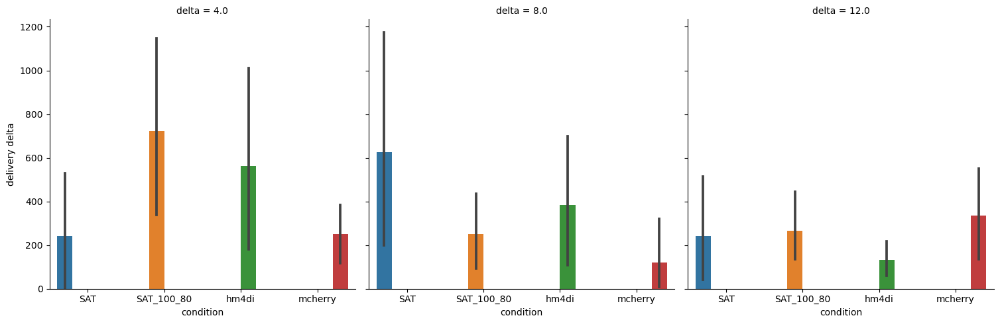

In [530]:
sns.catplot(perf_start, x="condition", y="delivery delta", col="delta", col_wrap=4, hue="condition", kind="bar")

c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])
c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])
c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
c:\Users\swind\miniconda3\envs\behavior\Lib\site-packages\matplotlib\axes\_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nan

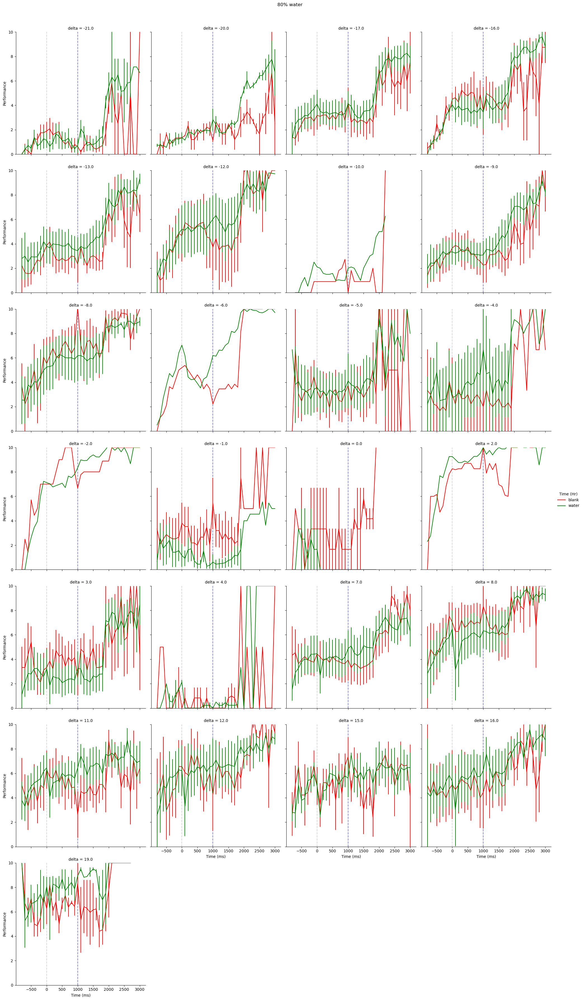

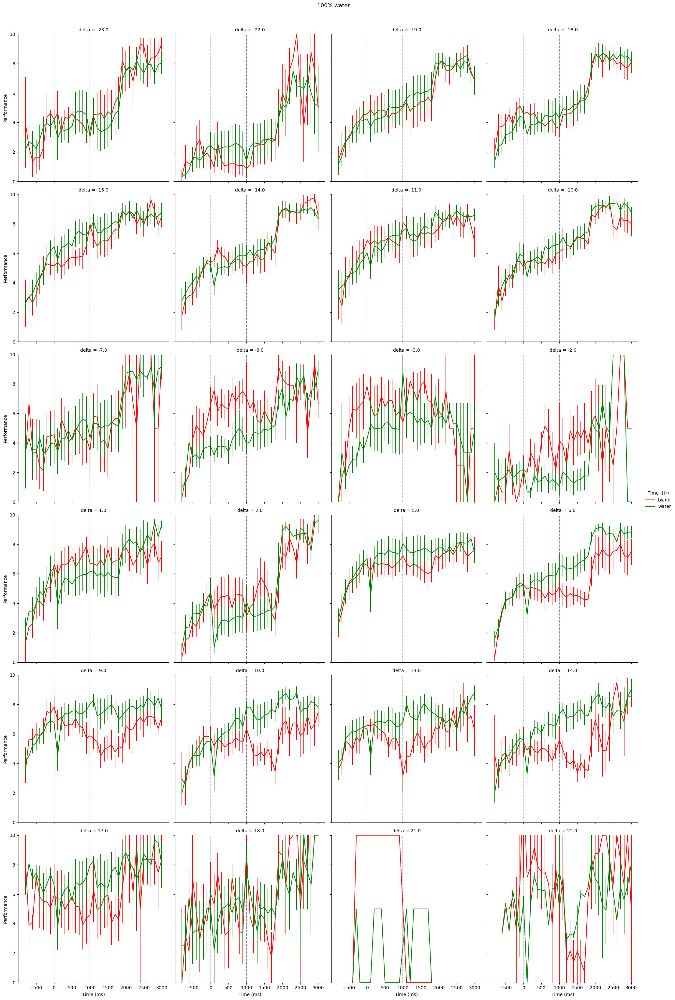

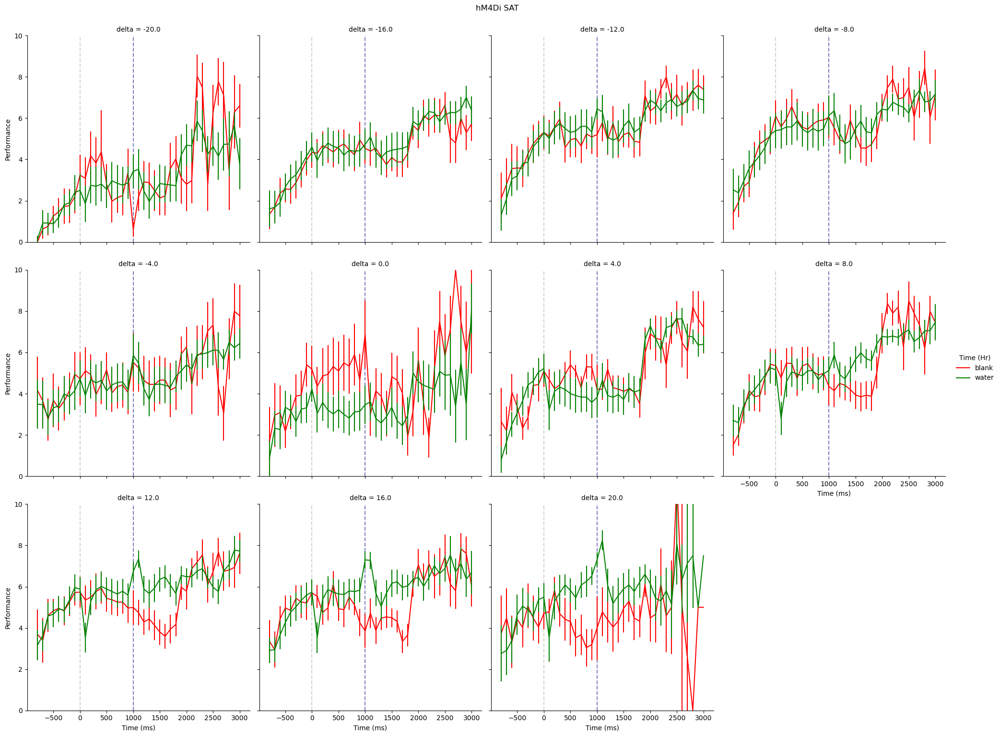

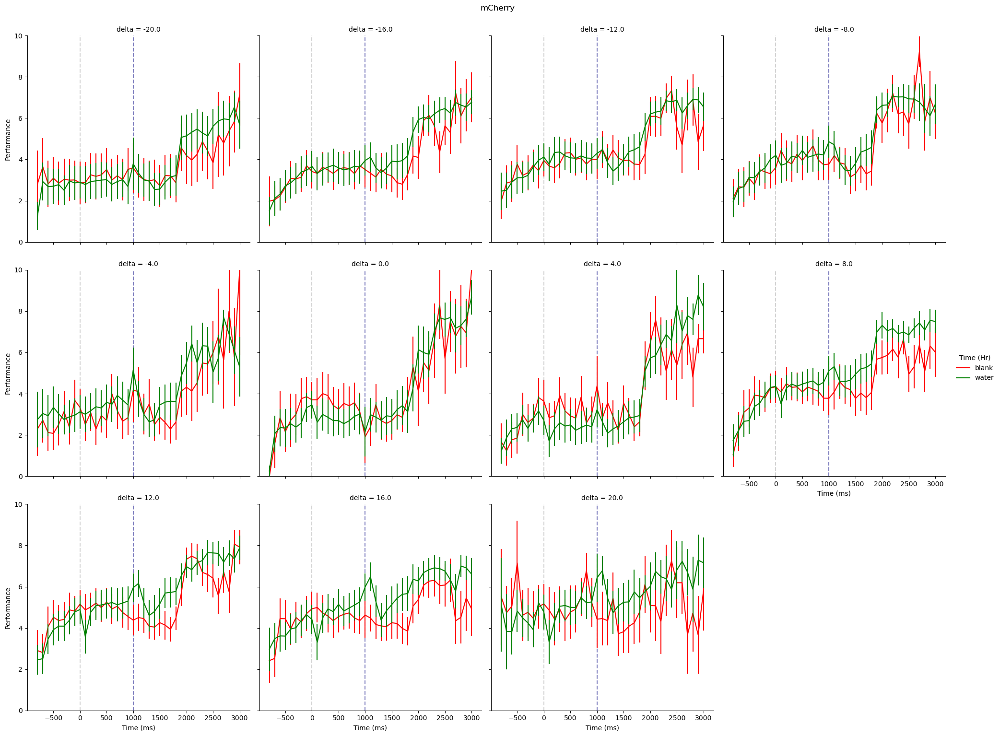

In [532]:
#licking to blank and water all timebins 100ms

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="delta", col_wrap=4,errorbar="se", err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("80% water", y=1.02)
tweakplot(g, 0, 10)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT_100_80"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("100% water", y=1.02)
tweakplot(g, 0, 10)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="hm4di"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("hM4Di SAT", y=1.02)
tweakplot(g, 0, 10)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="mcherry"], x="delivery delta", kind="line", y="lick", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("mCherry", y=1.02)
tweakplot(g, 0, 10)

C:\Users\swind\AppData\Local\Temp\ipykernel_10856\667028221.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  temp = perf2[(perf2["delivery delta"] >= 700) & (perf2["delivery delta"] < 1000)].groupby(["condition", "animal", "delta"]).mean()


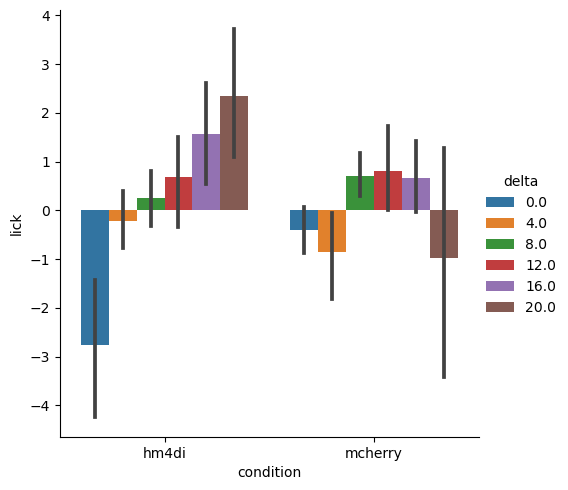

In [ ]:
temp = perf2[(perf2["delivery delta"] >= 700) & (perf2["delivery delta"] < 1000)].groupby(["condition", "animal", "delta"]).mean()
temp = temp.reset_index()
temp = temp[(temp["delta"] >= 0) & ((temp["condition"] == "hm4di") | (temp["condition"] == "mcherry"))] #
sns.catplot(temp, y="lick", x="condition", kind="bar", hue="delta")


#### Poke Analysis

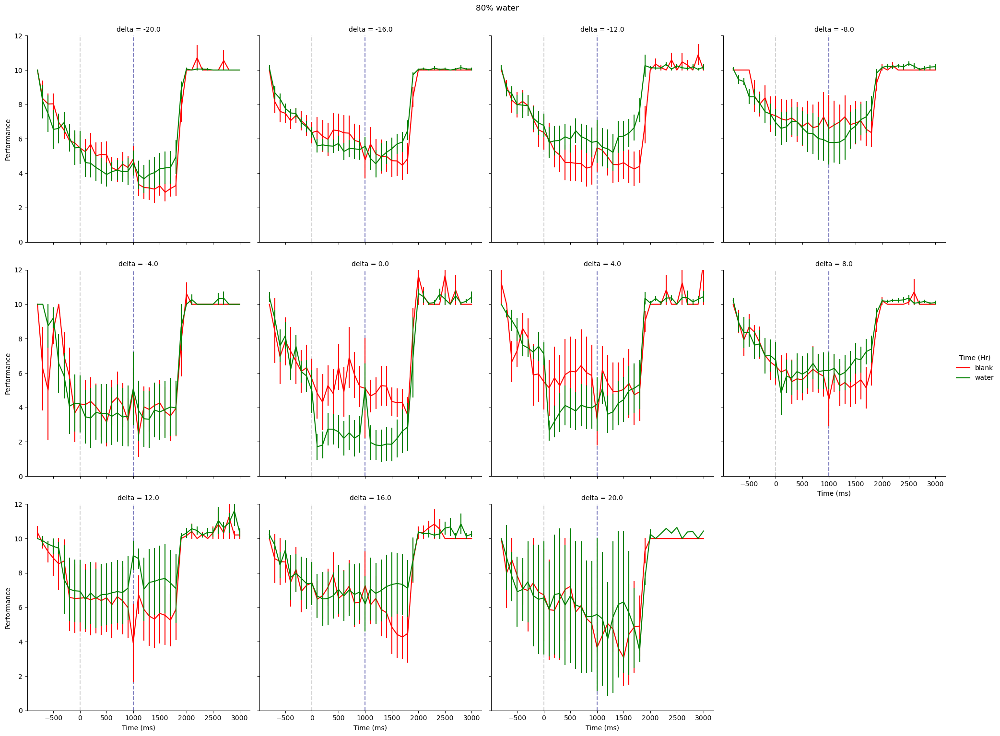

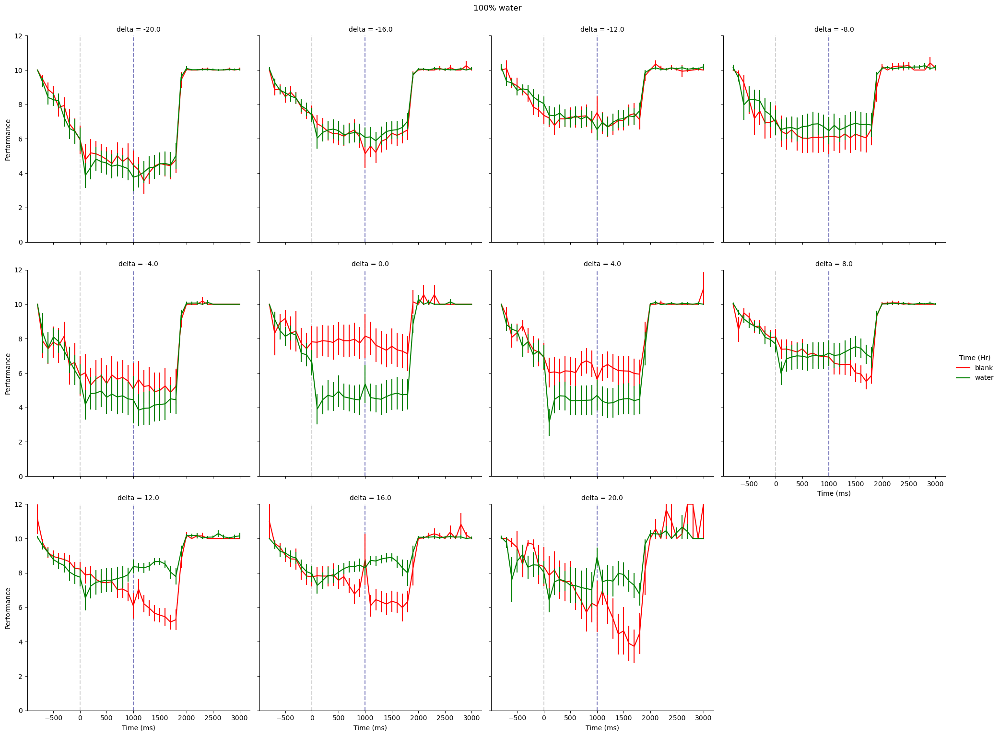

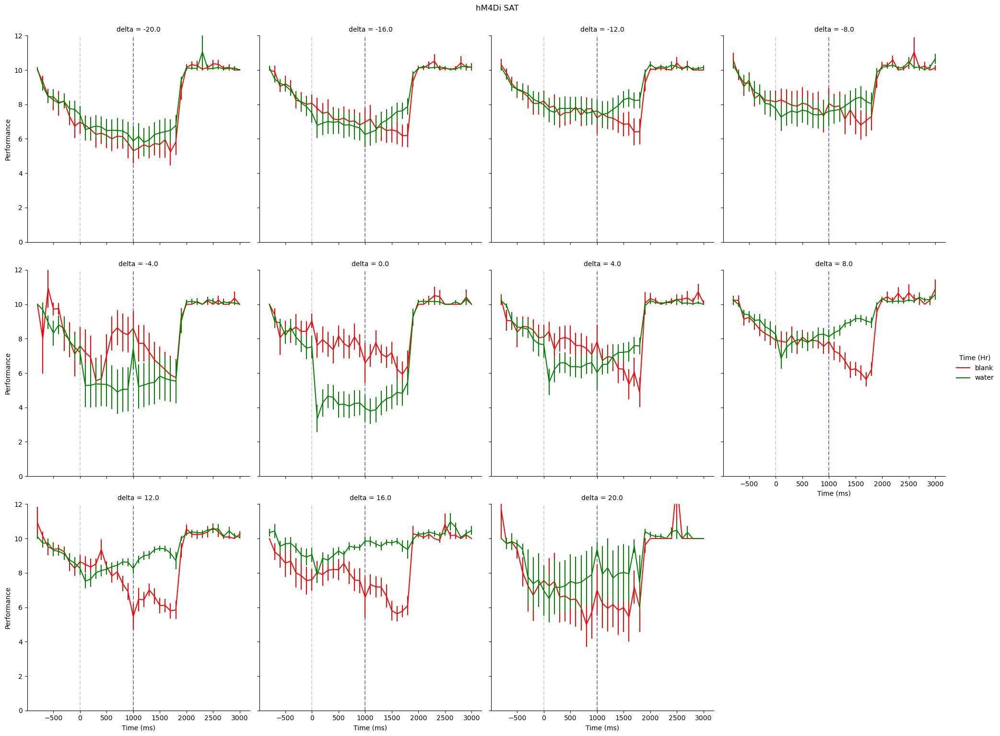

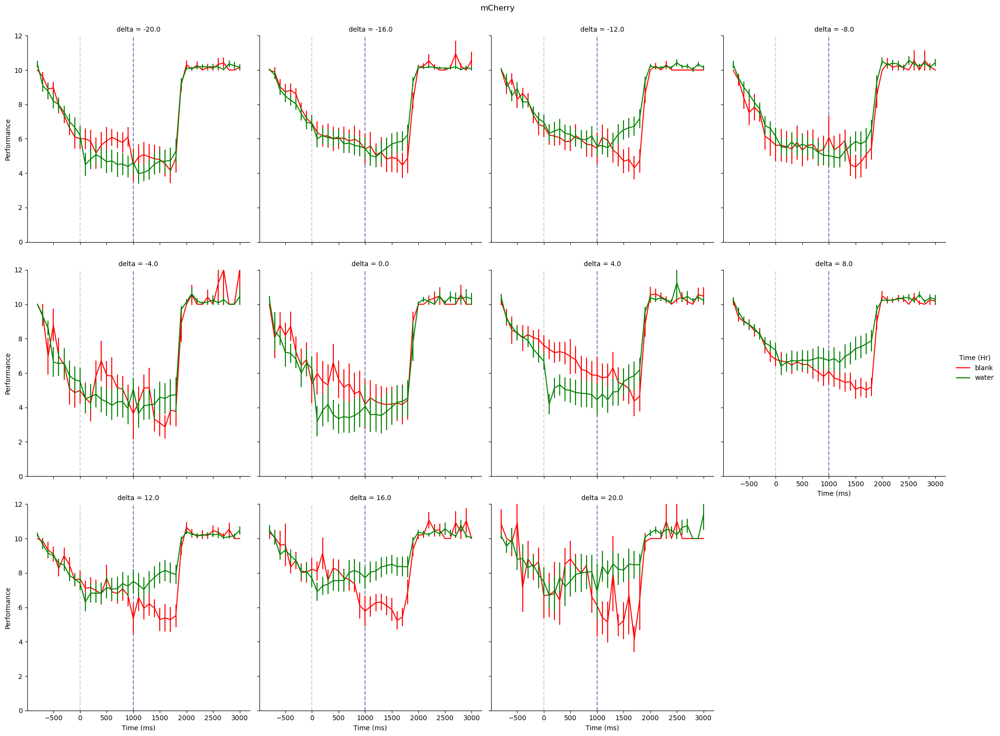

In [ ]:
#poke 100 ms by 4hour bin all conditions

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT"], x="delivery delta", kind="line", y="poke", hue="trial type", 
                palette=["red", "green"],col="delta", col_wrap=4,errorbar="se", err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("80% water", y=1.02)
tweakplot(g, 0, 12)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="SAT_100_80"], x="delivery delta", kind="line", y="poke", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("100% water", y=1.02)
tweakplot(g, 0, 12)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="hm4di"], x="delivery delta", kind="line", y="poke", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("hM4Di SAT", y=1.02)
tweakplot(g, 0, 12)

g = sns.relplot(lickfreq2[lickfreq2["condition"] =="mcherry"], x="delivery delta", kind="line", y="poke", hue="trial type", 
                palette=["red", "green"],col="delta", errorbar="se", col_wrap=4,err_style="bars")
#g.axes[0][0].set_title("Acclimation")
#g.axes[0][1].set_title("SAT first 8h")
#g.axes[0][2].set_title("SAT day 1")
g.fig.suptitle("mCherry", y=1.02)
tweakplot(g, 0, 12)

In [ ]:
def delta(data, key):
    '''calculates time since start of SAT. key is column to use to calculate'''
    data = data.set_index(["condition", "animal", "trial no"])
    delta = data[key] - data.sort_values(key).groupby("animal")[key].first() - data.groupby("animal")["acc"].first()
    data["delta"] = delta#.astype("timedelta64[m]")
    return data.reset_index()
delta(all_animals, "timestamp")

KeyError: "None of ['condition', 'animal', 'trial no'] are in the columns"

In [ ]:
#calculating poke length and number of pokes/ trial
aa = all_animals.reset_index()

ps = aa[(aa["poke"]==1) & (aa["poke"].shift() == 0)]
if aa["poke"].iloc[0] == 1:
    pd.concat([aa.iloc[[0]], ps])
pe = aa[(aa["poke"]==1) & (aa["poke"].shift(-1) == 0)]

pe[pe["animal"] == "GKO6 Mason"]
#poke_start = pd.concat([aa.iloc[[0]], aa[(aa["poke"]==1) & (aa["water"].shift() == 0)], aa.iloc[[aa.shape[0]-1]]])
#poke_end = pd.concat([aa.iloc[[0]], aa[(aa["poke"]==1) & (aa["water"].shift(-1) == 0)], aa.iloc[[aa.shape[0]-1]]])
#trial_boundaries = pd.concat([animal.iloc[[0]], animal[(animal["water"]!=7) & (animal["water"].shift() == 7)], animal.iloc[[animal.shape[0]-1]]])
pe_count = pe.groupby(["condition", "animal", "trial no"]).count()["poke"]
ps_count = ps.groupby(["condition", "animal", "trial no"]).count()["poke"]
ps_count[ps_count != pe_count]
aa["poke"].iloc[0]
#calculating poke length and number of pokes/ trial
aa = all_animals.reset_index()

ps = aa[(aa["poke"]==1) & (aa["poke"].shift() == 0)]
if (aa["poke"].iloc[0] == 1):
    ps = pd.concat([aa.iloc[[0]], ps])
pe = aa[(aa["poke"]==0) & (aa["poke"].shift() == 1)]

#number of pokes per trial - ps_count and pe_count are equal
pe_group = pe.groupby(["condition", "animal", "trial no"])
pe_count = pd.concat([pe_group["poke"].count(), pe_group["delta"].first()], axis=1)
ps_count = ps.groupby(["condition", "animal", "trial no"]).count()

#length of each poke
ps = ps.reset_index().set_index(["condition", "animal", "trial no"])
pe = pe.reset_index().set_index(["condition", "animal", "trial no"])
length = (pe["timestamp"] - ps["timestamp"]).rename("length")
length = pd.concat([length, ps["delivery delta"], ps["delta"]], axis=1)
length["length"] = length["length"].astype("timedelta64[ms]")
#length["delivery delta"] = length["delivery delta"].astype("timedelta64[ms]")
length
#statistical analysis -> 
#300 ms timebin
#slope
#list of animals
#more SAT animals/SAT animals with camera

KeyError: 'Column not found: delta'

In [ ]:
#average over bins?

#sns.relplot(pe_count, x="trial no", y="poke", hue="condition", kind="line", errorbar=None)
length[""]
length = length.reset_index().set_index("delta")
length = length.resample("60min").mean()
cond = (length["condition"] == "hm4di") | (length["condition"] == "mcherry")
sns.relplot(length[cond], x="delta", y="length", hue="condition", col="animal", col_wrap=4,kind="line", errorbar=None)



KeyError: ''

#### Anticipatory Licking vs Number of Trials

Summary: There is no correlation between the number of trials an animal performed in a time bin and its performance. This is true across the 100% water and 80% water conditions, and across timebins. 

In [ ]:
allfreq = getFreq(all_animals, -300, 0, "4h")
all_numtrials = getNumTrials(allfreq, "4h", True).rename({0:"numtrials"})
allfreq = resample_for_plot(allfreq, "lick", "4h", True, True).rename({0:"lick"})
#allfreq[allfreq["trial type"] == "perf"]
all_numtrials
allfreq
freqnum = pd.concat([all_numtrials, allfreq], axis=1).reset_index()
freqnum["delta"] = freqnum["delta"].astype("timedelta64[m]")/60
freqnum = freqnum.rename(columns={0:"numtrials", 1:"performance"})
cond = (freqnum["trial type"] == "perf") & (freqnum["delta"] < 24) & (freqnum["animal"] != "mean")

g = sns.lmplot(data=freqnum[cond & (freqnum["condition"] == "mcherry")], x="numtrials", y="performance", col="delta", col_wrap=4, ci=None)
g.fig.suptitle("Aniticpatory Performance (300 ms) vs Number of Trials 80% water", y=1.02)
g = sns.lmplot(data=freqnum[cond & (freqnum["condition"] == "SAT_100_80")], x="numtrials", y="performance",col="delta", col_wrap=4,ci=None)
g.fig.suptitle("Aniticpatory Performance (300 ms) vs Number of Trials 100% water", y=1.02)
#all_numtrials[all_numtrials["numtrials"] > 500]
#binned = all_animals.reset_index().groupby(["condition", "trial type", "animal", pd.Grouper(key="timestamp", freq="4h")])["trial no"].unique()
#binned
#all_animals

ValueError: cannot handle a non-unique multi-index!

#### How long after air is turned on does it take for mice to lick more to stimulus than to blank trials? 
- analyze licking in x ms bins continuously from air start <- rolling window
- look at each bin separately

In [ ]:
fq = freqCurve(all_animals, 100, 1)
#get ant lick 300ms
cond = (fq["delivery delta"] > -pd.to_timedelta(300, unit="ms")) & (fq["delivery delta"] < pd.to_timedelta(1000, unit="ms"))
antlick = fq[cond] 
antlick
#antlickperf = performance(antlick,0)
#delta = antlickperf["trial time"] - antlickperf.sort_values("trial time").groupby("animal")["trial time"].first() - antlickperf.groupby("animal")["acc"].first()
#delta = delta.astype("timedelta64[h]")
#antlickperf["delta"] = delta
#timetopos = antlickperf[(antlickperf["trial type"] == "perf") & (antlickperf["lick"] > 0.5) & (antlickperf["delta"] > 0)].sort_values("delta").groupby(["condition", "animal"]).first().reset_index()

#sns.catplot(timetopos, y="delta", x="condition", kind="bar")

,condition,trial no,trial type,delivery delta,trial time,lick,poke,acc
animal,,,,,,,,
GKO6 Mason,SAT,1,water,-1 days +23:59:59.800000,2019-05-01 12:00:00,0.0,0.0,1 days
GKO6 Mason,SAT,1,water,-1 days +23:59:59.900000,2019-05-01 12:00:00,0.0,0.0,1 days
GKO6 Mason,SAT,1,water,0 days 00:00:00,2019-05-01 12:00:00,0.0,0.0,1 days
GKO6 Mason,SAT,1,water,0 days 00:00:00.100000,2019-05-01 12:00:00,0.0,0.0,1 days
GKO6 Mason,SAT,1,water,0 days 00:00:00.200000,2019-05-01 12:00:00,0.0,0.0,1 days
...,...,...,...,...,...,...,...,...
NIO16,mcherry,705,water,0 days 00:00:00.500000,2022-12-09 12:00:00,10.0,10.0,1 days
NIO16,mcherry,705,water,0 days 00:00:00.600000,2022-12-09 12:00:00,0.0,10.0,1 days
NIO16,mcherry,705,water,0 days 00:00:00.700000,2022-12-09 12:00:00,0.0,10.0,1 days


### vigor/increase frequency late in consummatory licking

Conclusion: No Difference in licking across condition or delta

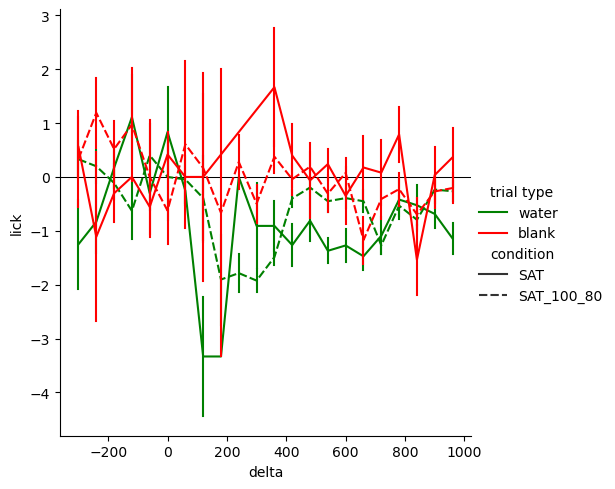

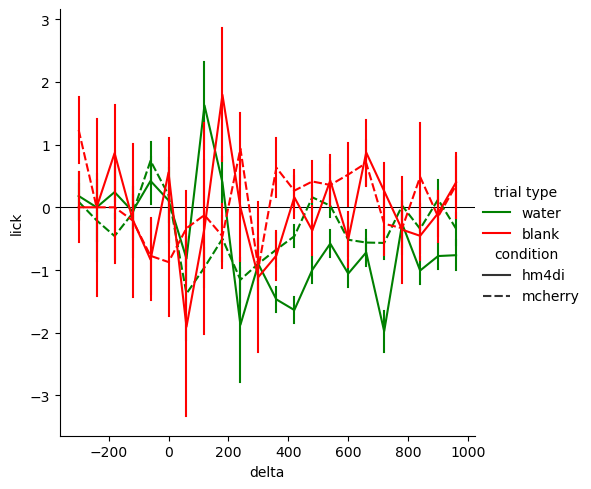

In [ ]:


def delta(data, key):
    '''calculates time since start of SAT. key is column to use to calculate'''
    data = data.set_index(["condition", "animal", "trial no"])
    delta = data[key] - data.sort_values(key).groupby("animal")[key].first() - data.groupby("animal")["acc"].first()
    data["delta"] = delta.astype("timedelta64[m]")
    return data.reset_index()

fq = delta(freqCurve(all_animals, 100, 1).reset_index(), "trial time")
es = pd.to_timedelta(-300, unit="ms")
ee = pd.to_timedelta(0, unit="ms")
ls = pd.to_timedelta(0, unit="ms")
le = pd.to_timedelta(300, unit="ms")
e = fq[(fq["delivery delta"] > es) & (fq["delivery delta"] <= ee)]
l = fq[(fq["delivery delta"] > ls) & (fq["delivery delta"] <= le)]
e = e.groupby(["condition", "animal", "trial no", "delta", "trial type"])[["lick", "poke"]].mean()
l = l.groupby(["condition", "animal", "trial no", "delta", "trial type"])[["lick", "poke"]].mean()
p = (l - e).reset_index()
p = p[(p["delta"] >= -300) & (p["delta"] < 1000)]
g = sns.relplot(p[(p["condition"] == "SAT") | (p["condition"] == "SAT_100_80")], x="delta", kind="line", y="lick",
                errorbar="se", err_style="bars", style="condition", hue="trial type", palette=["green", "red"])
g.axes[0][0].axhline(y=0, xmin=0, xmax=1, ls="-", lw=0.75,color="black", zorder=0)
g = sns.relplot(p[~((p["condition"] == "SAT") | (p["condition"] == "SAT_100_80"))], x="delta", kind="line", y="lick",
                errorbar="se", err_style="bars", style="condition", hue="trial type", palette=["green", "red"])
g.axes[0][0].axhline(y=0, xmin=0, xmax=1, ls="-", lw=0.75,color="black", zorder=0)

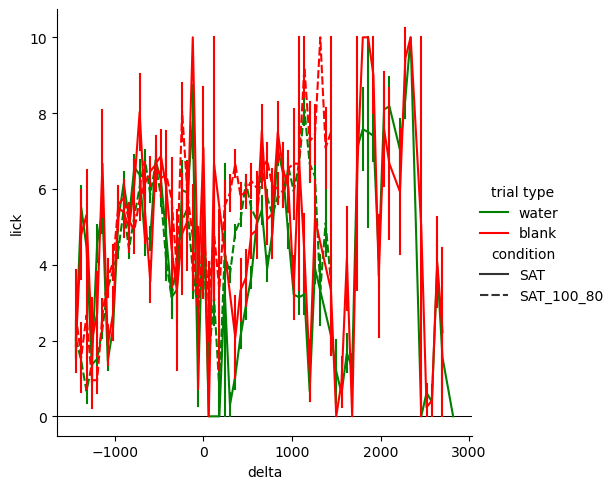

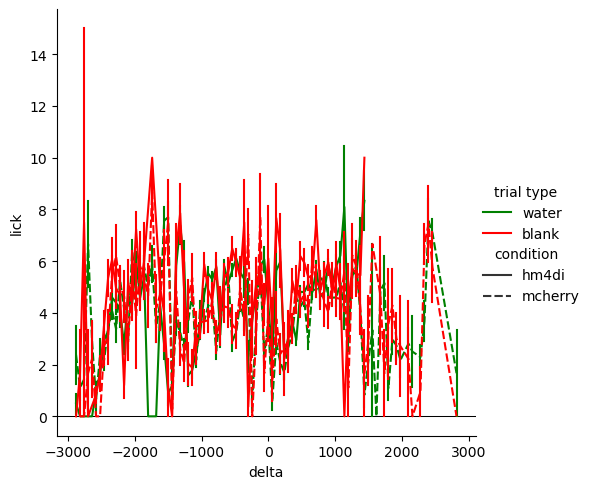

In [ ]:
g = sns.relplot(p[(p["condition"] == "SAT") | (p["condition"] == "SAT_100_80")], x="delta", kind="line", y="lick",
                errorbar="se", err_style="bars", style="condition", hue="trial type", palette=["green", "red"])
g.axes[0][0].axhline(y=0, xmin=0, xmax=1, ls="-", lw=0.75,color="black", zorder=0)
g = sns.relplot(p[~((p["condition"] == "SAT") | (p["condition"] == "SAT_100_80"))], x="delta", kind="line", y="lick",
                errorbar="se", err_style="bars", style="condition", hue="trial type", palette=["green", "red"])
g.axes[0][0].axhline(y=0, xmin=0, xmax=1, ls="-", lw=0.75,color="black", zorder=0)

My explanation - animals learn faster in the 100% water condition because the change in water probability occurs at the same time as the change in air puff, so the air puff is more salient to the change in probability.

My prediction - animals learn faster when the water probability is also changed when air is turned on because the air is a more salient signal

50%->50% => same

80%->50% =>  increase
             
50%->80% =>  increase

100%->50% => increase

80%->80% => same

100%->80% => increase

Is the rate of learning related to SST IPSC size in acclimation? -> hm4Di data (silencing of SST)

Is 85% rule for learning relevant? -> 100%->50% slower than 100%->80%; 50%->50% slower than 80%->80%; 85% -> 85%?

priming, evolution of behavior during learning task

In order to optimize mice the task, they recieve stimulus (water reward and air puff) trials 80% of the time, and blank (no water or puff) trials 20% of the time

#### Pretraining experience facilitates acquisition of a sensory association task

Sensory association training is an automated home-cage task that trains animals to associate an air puff with a water reward, where mice are acclimated to a training cage for 24 hours, then a gentle air puff is introduced for 24 hours of training. The eighty-five percent rule for learning (Wilson, .. Cohen, 2019) indicates that learning should be optimized when mice recieve stimulus (water reward and air puff) trials 80%-85% of the time, and blank (no water or puff) trials 15-20% of the time. However, prior experience influences the way that animals learn. Priming can be defined as the way that previous experience influences current behavior in a non-conscious way (Shackter and buffner, 1998; kristjansson 2023). In the context of task learning, this involves pre-exposure to an unrelated context prior to initiation of task learning that facilitates learning of the task. In this training paradigm, mice can be primed during the first 24h in the cage, during which they get used to the cage and lick port, and recieve water reward but no air, before they start learning the task. This analysis suggests that modulating probability of water delivery from the lick port during this pretraing period affects the way animals learn the task. In particular, animals that experience water delivery 100% of the time durning this pretraining period learn the task faster than animals that experience water delievery only 80% of the time.


Priming can be defined as a prior exposure to some stimulus 


In our training paradigm, mice can be primed during the first 24h in the cage, during which they get used to the cage and lick port, and recieve water reward but no air. The experience the mice have prior to initation of training affects the m


During this time, although there is no air puff for the animals to associate with the water reward, the probability of water can be adjusted.

The Eighty Five Percent Rule for optimal learning
eighty-five percent error rate is optimal for learning  - why use 

Priming of probabilistic attentional templates
 priming can be thought of as learning of the underlying probability density function of the target or distractor sets in a given continuous task.

Sequence Learning Induces Selectivity to Multiple Task Parameters in Mouse Somatosensory Cortex
Mice could respond to the earliest possible cues allowing discrimination, effectively solving the task as a “detection of change” problem, but enhanced their performance when responding later. 

 How is 100% water priming? why do 100% mice learn faster than 80% mice? -> motivation/expectation of water delivery?

 Detection not only of change in water probability and in presence of air puff

Evidence for Neural Effects of Repetition that Directly Correlate with Behavioral Priming
 Stimulus repetition associates with neural activity reductions during tasks that elicit behavioral priming

 Mouse expects to get water from lick port -> go to lick port with expectation

 Pretraining experience facilitates acquisition of a sensory association task

\# of trials vs performance - no correlation

Time to learn that 

Does water probability in acclimation affect the rate at which animals learn the task?

And the strength of the association? (how soon after air puff animals start licking)


#### Abstract

Pretraining experience facilitates acquisition of a sensory association task

Sensory association training is an automated home-cage task that trains animals to associate an air puff with a water reward, where mice are acclimated to a training cage for 24 hours, then a gentle air puff is introduced for 24 hours of training.  During the training, they receive water and puff trials 80% of the time, and blank trials 20% of the time. 

The

This behavioral analysis indicates that animals learn the SAT task faster when they recieve a water reward 100% of the time during acclimation, suggesting that this expericence during acclimation primes animals to learn the sensory task.



It has been shown that there is depression in somatostatin (SST) synapses onto pyramidal cells in barrel cortex (S1BF) after 24 hours of SAT, as measured by SST IPSC. When a SST IPSC reduction is chemogenetically, animals appear to learn slightly faster. Additionally, the magnitude of SST IPSC is associated with water probability during acclimation. In particular, animals have a reduced IPSC in acclimation with 100% water relative to animals that receive water 80% of the time in acclimation. 


Bernhard Barth 2020 - aniticipatory licking is a measure of how the animals learn the task
Other Barth papers - anticipatory licking analysis, but not trial curves

Sensory association training is an automated home-cage task that trains animals to associate an air puff with a water reward. Previous work has shown that learning the 
task leads to an increase in SST IPSC, but initially putting animals into cages for lowers SST IPSC. The magnitude of the SST IPSC has additionally been shown to be associated with water delivery probability during SAT. Animals seem to learn the task faster with artifical suppression of SST output with DREADDs. Priming animals with 100% water acclimation has a similar effect on SST output, but it is unclear if animals learn faster. This analysis suggests that 100% water animals are able to learn the tast faster than 80% water animals, as the begin anticipatory licking sooner and



Learning in this task is associated with changes to SST IPSC (Eunsol) and (as well as other changes to in brain (Matt - SAT5 SST inputs, me - SST output))
Data suggests that initial SST 

Why is this interesting? 
Animals seem to learn the task faster with artifical suppression of SST output with DREADDs. Priming animals with 100% water acclimation has a similar effect on SST output, but it is unclear if animals learn faster. This analysis suggests that 100% water animals are able to learn the tast faster than 80% water animals, as the begin anticipatory licking sooner and

all trials for each animal 
- water lick
- blank lick

4h bins performance by animal
- all bins
- just first and last

manual binning of trials
- less than 0 (before puff)
- first 8 hours
- rest of time


8h bins
after hm4di - learn faster
day = last 16

driver of sst plasticity 



associate number of trials with 

bin by 4h but split by intertrial interval, performance on first 